## 3. Find Units that are differentially engaged in fragmented replay

In [2]:
%load_ext autoreload
%autoreload 2

In [3]:
import os
import numpy as np
import datajoint as dj
import spyglass as nd
import pandas as pd
import matplotlib.pyplot as plt
import json
import multiprocessing

# ignore datajoint+jupyter async warnings
import warnings
warnings.simplefilter('ignore', category=DeprecationWarning)
warnings.simplefilter('ignore', category=ResourceWarning)

from spyglass.common import (Session, IntervalList,LabMember, LabTeam, Raw, Session, Nwbfile,
                            Electrode,LFPBand,interval_list_intersect)
from spyglass.common import TaskEpoch
import spyglass.spikesorting.v0 as ss

from spyglass.spikesorting.v0 import (SortGroup, 
                                    SortInterval,
                                    SpikeSortingPreprocessingParameters,
                                    SpikeSortingRecording, 
                                    SpikeSorterParameters,
                                    SpikeSortingRecordingSelection,
                                    ArtifactDetectionParameters, ArtifactDetectionSelection,
                                    ArtifactRemovedIntervalList, ArtifactDetection,
                                      SpikeSortingSelection, SpikeSorting,
                                   CuratedSpikeSortingSelection,CuratedSpikeSorting,Curation)
from spyglass.spikesorting.v0.curation_figurl import CurationFigurl,CurationFigurlSelection
from spyglass.spikesorting.v0.spikesorting_curation import MetricParameters,MetricSelection,QualityMetrics
from spyglass.spikesorting.v0.spikesorting_curation import WaveformParameters,WaveformSelection,Waveforms
from spyglass.common.common_position import IntervalPositionInfo, IntervalPositionInfoSelection,IntervalLinearizedPosition

from spyglass.utils.nwb_helper_fn import get_nwb_copy_filename
from pprint import pprint
from spyglass.shijiegu.ripple_detection import removeDataBeforeTrial1
from spyglass.shijiegu.helpers import interpolate_to_new_time
from spyglass.shijiegu.placefield import place_field,placefield_to_peak1dloc
from spyglass.shijiegu.Analysis_SGU import DecodeResultsLinear
warnings.simplefilter("ignore", category=DeprecationWarning)
warnings.simplefilter("ignore", category=ResourceWarning)
warnings.filterwarnings('ignore')

[2025-04-22 22:05:25,336][INFO]: Connecting shijiegu-alt@lmf-db.cin.ucsf.edu:3306
[2025-04-22 22:05:25,397][INFO]: Connected shijiegu-alt@lmf-db.cin.ucsf.edu:3306


In [4]:
SpikeSortingPreprocessingParameters()

preproc_params_name,preproc_params
default,=BLOB=
default_hippocampus,=BLOB=
default_min_seg,=BLOB=
franklab_default_hippocampus,=BLOB=
franklab_default_hippocampus_min_segment_length,=BLOB=
franklab_tetrode_hippocampus,=BLOB=
franklab_tetrode_hippocampus_min_seg,=BLOB=
lf_test,=BLOB=


In [5]:
(SpikeSortingPreprocessingParameters() & {'preproc_params_name':'default_hippocampus'}).fetch1('preproc_params')

{'frequency_min': 600, 'frequency_max': 6000, 'margin_ms': 5, 'seed': 0}

In [6]:
from spyglass.shijiegu.helpers import interval_union
from spyglass.shijiegu.Analysis_SGU import TrialChoice,RippleTimes,EpochPos,ExtendedRippleTimes,RippleTimesWithDecode
from spyglass.shijiegu.load import load_run_sessions
from spyglass.shijiegu.singleUnit import (do_mountainSort,electrode_unit,RippleTime2FiringRate,findWaveForms,RippleTime2Index,
                            )
from spyglass.shijiegu.fragmented import permute_frag_cont,find_spike_count_ratio

In [7]:
outputFolder='/cumulus/shijie/recording_pilot/lewis/FragmentedReplay/'

In [156]:
#nwb_copy_file_name = "lewis20240109_.nwb"
nwb_copy_file_name = "eliot20221021_.nwb"
#nwb_copy_file_name = "molly20220416_.nwb"
#nwb_copy_file_name = "haydn20230604_.nwb"

In [157]:
run_session_ids, run_session_names, pos_session_names = load_run_sessions(nwb_copy_file_name)

*nwb_file_name *epoch    epoch_name     position_inter
+------------+ +-------+ +------------+ +------------+
eliot20221021_ 1         01_Seq2Sleep1  pos 0 valid ti
eliot20221021_ 2         02_Seq2Session pos 1 valid ti
eliot20221021_ 3         03_Seq2Sleep2  pos 2 valid ti
eliot20221021_ 4         04_Seq2Session pos 3 valid ti
eliot20221021_ 5         05_Seq2Sleep3  pos 4 valid ti
eliot20221021_ 6         06_Seq2Session pos 5 valid ti
eliot20221021_ 7         07_Seq2Sleep4  pos 6 valid ti
eliot20221021_ 8         08_Seq2Session pos 7 valid ti
eliot20221021_ 9         09_Seq2Sleep5  pos 8 valid ti
 (Total: 9)



In [174]:
epoch_num = 3
session_name = run_session_names[epoch_num]
pos_name = pos_session_names[epoch_num]

In [175]:
session_name

'08_Seq2Session4'

In [176]:
try:
    ripple_times = pd.DataFrame((RippleTimesWithDecode & 
                             {'nwb_file_name': nwb_copy_file_name, 'interval_list_name': session_name}).fetch1('ripple_times'))
except:
    ripple_times = pd.read_pickle((RippleTimesWithDecode & 
                             {'nwb_file_name': nwb_copy_file_name, 'interval_list_name': session_name}).fetch1('ripple_times'))
    

### Get spike data:
The function `electrode_unit` finds you nwb_units which includes spike times for all units.
Then the function `RippleTime2FiringRate` finds the firing rate in ripples

In [177]:
curation_id = 1

In [178]:
key = {"nwb_file_name": nwb_copy_file_name,
       "sorter":"mountainsort4",
       "sort_interval_name":session_name}

sort_group_ids_with_good_cell = []
sort_group_ids = np.unique((QualityMetrics & key).fetch("sort_group_id"))
for sort_group_id in sort_group_ids:
    nwb_units = electrode_unit(nwb_copy_file_name,session_name,sort_group_id,curation_id = curation_id)
    
    #print("\n here")
    if nwb_units is None or len(nwb_units)==0:
        #print("\nhere", sort_group_id)
        continue
    print(len(nwb_units))
    sort_group_ids_with_good_cell.append(sort_group_id)
print(sort_group_ids_with_good_cell)

4
1
5
11
12
6
12
6
1
10
1
2
3
2
[0, 2, 5, 13, 14, 16, 17, 20, 23, 26, 27, 29, 30, 31]


In [179]:
from spyglass.shijiegu.fragmented import get_nwb_units

In [180]:
nwb_units_all = get_nwb_units(nwb_copy_file_name,session_name,sort_group_ids_with_good_cell,curation_id = curation_id)

### find the firing ratio between frag and cont, define RATIO_THRESHOLD using this histogram

Text(0.5, 1.0, 'eliot20221021_.nwb\n08_Seq2Session4\n histogram of spike count fragmented/continuous replays  76 cells.')

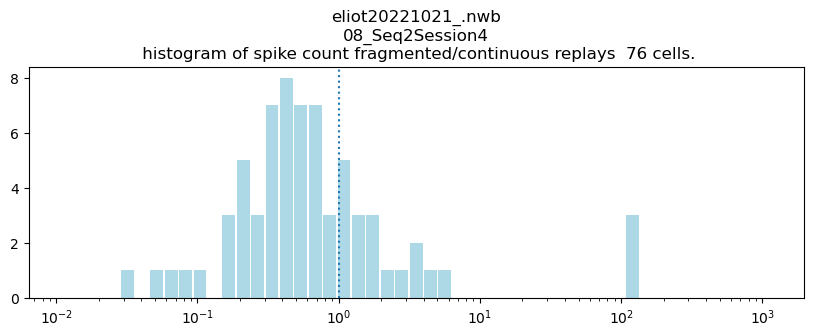

In [181]:
count_ratio, _, firing_rate_F, firing_rate_C, _  = find_spike_count_ratio(nwb_units_all,ripple_times)

logbins = np.logspace(np.log10(0.01),np.log10(1000),50)
hist_data, bins = np.histogram(count_ratio,logbins);

fig,ax = plt.subplots(1,1,figsize = (10,3))

ax.bar(logbins[1:],hist_data,color = 'lightblue',width = np.diff(logbins))
ax.set_xscale('log')
ax.axvline(1,linestyle = ':')
#ax.set_xticks(np.log([0.01,]))
ax.set_title(nwb_copy_file_name + '\n' + session_name + '\n histogram of spike count fragmented/continuous replays  '+
            f"{len(count_ratio)} cells.")

In [182]:
print(f"There are {len(count_ratio)} cells.")

There are 76 cells.


### rate_ratio

Text(0.5, 1.0, 'eliot20221021_.nwb\n08_Seq2Session4\n histogram of firing rate fragmented/continuous replays  76 cells.')

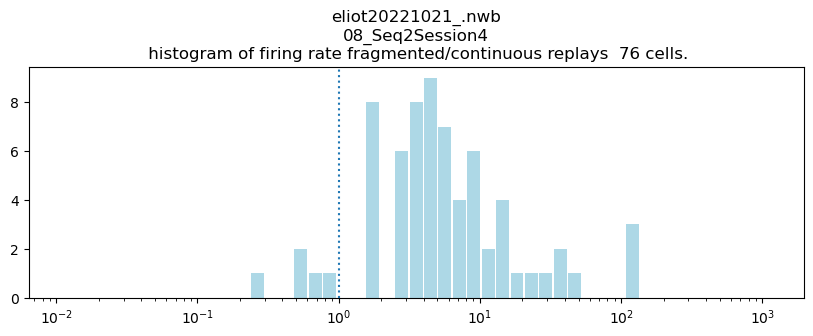

In [183]:
rate_ratio, _, firing_rate_F, firing_rate_C, _ = find_spike_count_ratio(nwb_units_all,ripple_times,use_rate = True)

logbins = np.logspace(np.log10(0.01),np.log10(1000),50)
hist_data, bins = np.histogram(rate_ratio,logbins);

fig,ax = plt.subplots(1,1,figsize = (10,3))

ax.bar(logbins[1:],hist_data,color = 'lightblue',width = np.diff(logbins))
ax.set_xscale('log')
ax.axvline(1,linestyle = ':')

ax.set_title(nwb_copy_file_name + '\n' + session_name + '\n histogram of firing rate fragmented/continuous replays  '+
            f"{len(rate_ratio)} cells.")

In [ ]:
## make random permuted
logbins = np.logspace(np.log10(0.01),np.log10(100),50)
hist_data_random = []
for b in range(100):
    print(b)
    ripple_times_random = permute_frag_cont(ripple_times)
    ratio_random, _, _1 = find_spike_count_ratio(nwb_units_all,ripple_times_random)
    hist_data, bins = np.histogram(ratio_random,logbins);
    hist_data_random.append(hist_data)
    

In [49]:
hist_data_random = np.array(hist_data_random)
#hist_data_random_25 = np.quantile(hist_data_random, 0.025/len(logbins), axis = 0)
#hist_data_random_75 = np.quantile(hist_data_random, 1 - 0.025/len(logbins), axis = 0)
hist_data_random_25 = np.quantile(hist_data_random, 0.025, axis = 0)
hist_data_random_75 = np.quantile(hist_data_random, 1 - 0.025, axis = 0)

Text(0.5, 1.0, 'histogram of spike count fragmented/continuous replays')

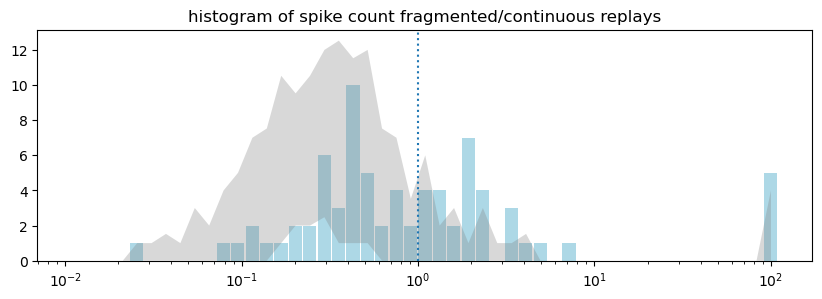

In [50]:
logbins = np.logspace(np.log10(0.01),np.log10(100),50)

fig,ax = plt.subplots(1,1,figsize = (10,3))

hist_data, bins = np.histogram(ratio,logbins);
ax.bar(logbins[1:],hist_data,color = 'lightblue',width = np.diff(logbins))
ax.fill_between(logbins[1:],
                hist_data_random_25,
                hist_data_random_75, facecolor='gray',alpha=0.3)

ax.set_xscale('log')
ax.axvline(1,linestyle = ':')
#ax.set_xticks(np.log([0.01,]))
ax.set_title('histogram of spike count fragmented/continuous replays')


### total spike count during fragmented or continous

In [55]:
count_F = 0
for e in firing_rate_F.keys():
    for u in firing_rate_F[e].keys():
        count_F = count_F + firing_rate_F[e][u][1]

count_C = 0
for e in firing_rate_C.keys():
    for u in firing_rate_C[e].keys():
        count_C = count_C + firing_rate_C[e][u][1]

In [56]:
print(count_F,count_C)

841.0 2095.0


### Define `cells_frag` and `cells_cont` for cells that engage preferentially with fragmented replays

In [58]:
RATIO_FRAG = 1.5
RATIO_CONT = 0.5
cells_cont = []
cells_frag = []

for e in sort_group_ids_with_good_cell:
    for u in list(firing_rate_F[e].keys()):

        (rate_F, count_F, _) = firing_rate_F[e][u]
        print('electrode '+ str(e) + ' unit ' + str(u))
        print('during fragmented replay: ',rate_F, count_F)
    
        (rate_C, count_C, _) = firing_rate_C[e][u]
        print('during cont replay: ',rate_C, count_C)
        if count_C == 0 and count_F > 2:
            cells_frag.append((e,u))
            continue
    
        if count_C > 0 and count_F/count_C > RATIO_FRAG:
            cells_frag.append((e,u))
        elif count_C > 0 and count_F/count_C < RATIO_CONT:
            cells_cont.append((e,u))

electrode 0 unit 3
during fragmented replay:  7.304430676138095 31.0
during cont replay:  3.709264109928835 84.0
electrode 0 unit 4
during fragmented replay:  0.23562679600445469 1.0
during cont replay:  0.04415790607058137 1.0
electrode 0 unit 6
during fragmented replay:  2.8275215520534562 12.0
during cont replay:  1.9871057731761617 45.0
electrode 0 unit 7
during fragmented replay:  3.5344019400668203 15.0
during cont replay:  0.7506844031998833 17.0
electrode 0 unit 8
during fragmented replay:  1.1781339800222734 5.0
during cont replay:  0.1324737182117441 3.0
electrode 2 unit 3
during fragmented replay:  2.356267960044547 10.0
during cont replay:  1.1481055578351156 26.0
electrode 5 unit 2
during fragmented replay:  0.0 0.0
during cont replay:  0.9273160274822088 21.0
electrode 5 unit 5
during fragmented replay:  2.120641164040092 9.0
during cont replay:  0.30910534249406957 7.0
electrode 5 unit 6
during fragmented replay:  0.23562679600445469 1.0
during cont replay:  0.0 0.0
elec

Text(0.2, 2.5, 'continuous replay total duration (s):22.6')

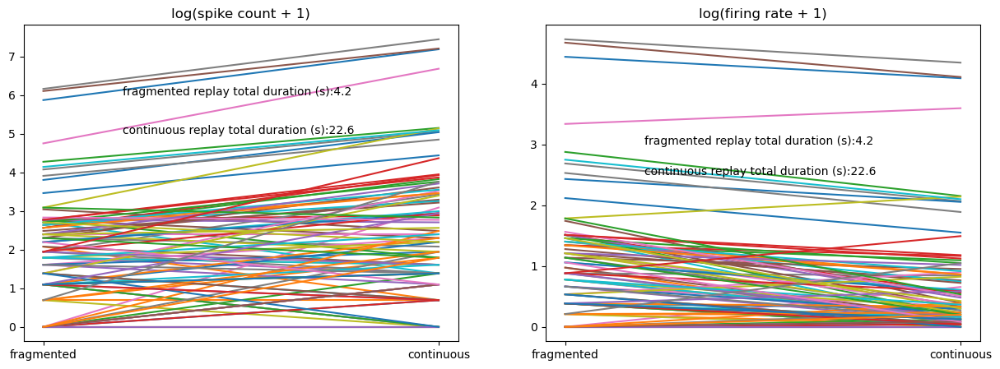

In [802]:
fig, axes = plt.subplots(1,2,figsize = (15,5*1))
for e in sort_group_ids_with_good_cell :
    for u in list(firing_rate_F[e].keys()):
        axes[0].plot([0,1],[np.log(firing_rate_F[e][u][1]+1),np.log(firing_rate_C[e][u][1]+1)])
axes[0].set_xticks([0,1])
axes[0].set_xticklabels(['fragmented','continuous'])
axes[0].set_title('log(spike count + 1)')
axes[0].text(0.2,6,"fragmented replay total duration (s):"+str(np.round(firing_rate_F[e][u][2],1)))
axes[0].text(0.2,5,"continuous replay total duration (s):"+str(np.round(firing_rate_C[e][u][2],1)))

for e in sort_group_ids_with_good_cell :
    for u in list(firing_rate_F[e].keys()):
        axes[1].plot([0,1],[np.log(firing_rate_F[e][u][0]+1),np.log(firing_rate_C[e][u][0]+1)])
        
axes[1].set_title('log(firing rate + 1)')
axes[1].set_xticks([0,1])
axes[1].set_xticklabels(['fragmented','continuous'])

axes[1].text(0.2,3,"fragmented replay total duration (s):"+str(np.round(firing_rate_F[e][u][2],1)))
axes[1].text(0.2,2.5,"continuous replay total duration (s):"+str(np.round(firing_rate_C[e][u][2],1)))

### plot waveforms for cells that fired more during continuous replay

In [349]:
"""
def electrode_unit2list(cells_cont):
    electrodes_cont = np.unique([u[0] for u in cells_cont])
    cells_cont_dict = []
    for e in electrodes_cont:
        tmp = []
        for c in cells_cont:
            if c[0] == e:
                tmp.append(c[1])
        cells_cont_dict.append(tmp)
    return electrodes_cont,cells_cont_dict

electrodes_cont,cells_cont_dict = electrode_unit2list(cells_cont)
electrodes_frag,cells_frag_dict = electrode_unit2list(cells_frag)
print(electrodes_cont)
"""

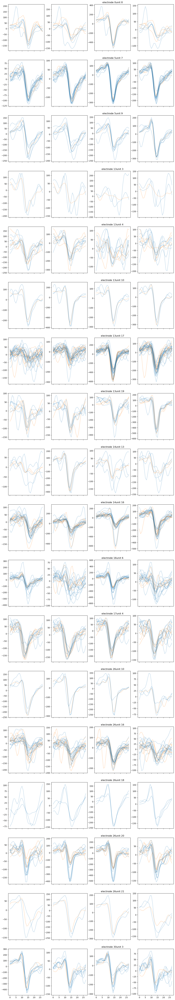

In [783]:
fig, axes = plt.subplots(len(cells_frag),4,figsize = (15,5*len(cells_frag)),sharex = 1)

row_ind = 0
for row_ind in range(len(cells_frag)):
    e = cells_frag[row_ind][0]
    u = cells_frag[row_ind][1]
    nwb_units,extractor = findWaveForms(nwb_copy_file_name,session_name,e)
    waveforms = extractor.get_waveforms(u)

    # continuous time waveforms
    ind_cont = RippleTime2Index(nwb_units.loc[u].spike_times,ripple_times,fragFlag = False)
    (sample_num,clip_size,channel_num) = waveforms.shape
    
    for s_ind in range(len(ind_cont)):
        s = ind_cont[s_ind]
        for ch in range(channel_num):
            axes[row_ind,ch].plot(waveforms[s,:,ch].squeeze(),'C1',alpha = 0.3)

    # fragmented time waveforms
    ind_frag = RippleTime2Index(nwb_units.loc[u].spike_times,ripple_times,fragFlag = True)
    (sample_num,clip_size,channel_num) = waveforms.shape
    
    for s_ind in range(len(ind_frag)):
        s = ind_frag[s_ind]
        for ch in range(channel_num):
            axes[row_ind,ch].plot(waveforms[s,:,ch].squeeze(),'C0',alpha = 0.3)
            
    axes[row_ind,2].set_title('electrode '+str(e)+'unit '+str(u))

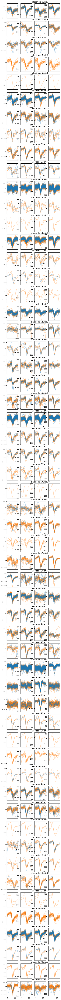

In [784]:
fig, axes = plt.subplots(len(cells_cont),4,figsize = (6,2*len(cells_cont)),sharex = 1)

row_ind = 0
for row_ind in range(len(cells_cont)):
    e = cells_cont[row_ind][0]
    u = cells_cont[row_ind][1]
    nwb_units,extractor = findWaveForms(nwb_copy_file_name,session_name,e)
    waveforms = extractor.get_waveforms(u)

    # continuous time waveforms
    ind_cont = RippleTime2Index(nwb_units.loc[u].spike_times,ripple_times,fragFlag = False)
    (sample_num,clip_size,channel_num) = waveforms.shape
    
    for s_ind in range(len(ind_cont)):
        s = ind_cont[s_ind]
        for ch in range(channel_num):
            axes[row_ind,ch].plot(waveforms[s,:,ch].squeeze(),'C1',alpha = 0.3)

    # fragmented time waveforms
    ind_frag = RippleTime2Index(nwb_units.loc[u].spike_times,ripple_times,fragFlag = True)
    (sample_num,clip_size,channel_num) = waveforms.shape
    
    for s_ind in range(len(ind_frag)):
        s = ind_frag[s_ind]
        for ch in range(channel_num):
            axes[row_ind,ch].plot(waveforms[s,:,ch].squeeze(),'C0',alpha = 0.3)
            
    axes[row_ind,2].set_title('electrode '+str(e)+'unit '+str(u))

### plot placefield for the cells

In [252]:
electrode_ind = 0
e = electrodes_frag[electrode_ind]
units = cells_frag_dict[electrode_ind]
nwb_units,extractor = findWaveForms(nwb_copy_file_name,session_name,e)

In [439]:
#cells_frag

**Just looking at these promising units place field**

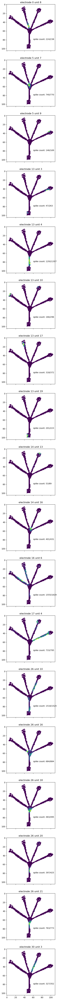

In [785]:
fig, axes = plt.subplots(len(cells_frag),1,figsize = (5,5*len(cells_frag)),sharex = 1)

row_ind = 0
#for electrode_ind in range(len(electrodes_frag)):
for row_ind in range(len(cells_frag)):
    e = cells_frag[row_ind][0]
    u = cells_frag[row_ind][1]
    placefield, xbins, ybins, mobility_spike_count, all_spike_count = place_field(nwb_copy_file_name, session_name, pos_name, e, u)
    axes[row_ind].imshow(placefield)
    axes[row_ind].text(60,80,'spike count: '+str(mobility_spike_count)+'/'+str(all_spike_count))
    axes[row_ind].set_title('electrode '+str(e) +' unit '+str(u))
        
    row_ind = row_ind + 1

### animal location of fragmented replays

In [786]:
from spyglass.shijiegu.singleUnit import ParticipatedRippleIndex

frag_ripple_index = {}
for row_ind in range(len(cells_frag)):
    e = cells_frag[row_ind][0]
    u = cells_frag[row_ind][1]
    frag_ripple_index[(e,u)] = np.unique(ParticipatedRippleIndex(nwb_copy_file_name,session_name,
                            ripple_times,e,u,fragFlag = True))
cont_ripple_index = {}
for row_ind in range(len(cells_frag)):
    e = cells_frag[row_ind][0]
    u = cells_frag[row_ind][1]
    cont_ripple_index[(e,u)] = np.unique(ParticipatedRippleIndex(nwb_copy_file_name,session_name,
                            ripple_times,e,u,fragFlag = False))


In [788]:
frag_ripple_index

{(0, 8): array([ 63, 119, 132, 156]),
 (5, 7): array([ 49,  81, 154, 156, 160, 172]),
 (5, 9): array([ 26,  72, 132, 138, 150]),
 (13, 3): array([138, 142]),
 (13, 4): array([ 20, 119, 155, 156]),
 (13, 10): array([ 26, 142]),
 (13, 17): array([ 54,  92,  96, 121, 138, 150, 157]),
 (13, 19): array([100, 138, 156]),
 (14, 13): array([ 20,  78, 163]),
 (14, 16): array([  5,  26,  72,  92, 105, 120, 132, 138, 154, 159]),
 (16, 6): array([  5,  24,  63,  72, 138]),
 (17, 4): array([ 26,  49, 132, 142, 150, 154, 159]),
 (26, 10): array([ 24,  72, 150]),
 (26, 16): array([  5,  39,  71,  85, 121, 128, 132, 150, 154, 176]),
 (26, 18): array([138, 150]),
 (26, 20): array([ 62,  85, 119, 120, 128, 154, 176]),
 (26, 21): array([154, 156]),
 (30, 3): array([ 63,  75, 142, 172])}

In [789]:
frag_animal_loc = {}
for row_ind in range(len(cells_frag)):
    e = cells_frag[row_ind][0]
    u = cells_frag[row_ind][1]
    ripple_indices = frag_ripple_index[(e,u)]
    frag_animal_loc[(e,u)] = [ripple_times.loc[r_ind].animal_location for r_ind in ripple_indices]

In [790]:
frag_animal_loc

{(0, 8): ['home', 'home', 'home', 'home'],
 (5, 7): ['home', 'home', 'home', 'home', 'home', 'home'],
 (5, 9): ['home', 'well2', 'home', 'home', 'home'],
 (13, 3): ['home', 'well1'],
 (13, 4): ['home', 'home', 'home', 'home'],
 (13, 10): ['home', 'well1'],
 (13, 17): ['home', 'home', 'well3', 'home', 'home', 'home', 'home'],
 (13, 19): ['home', 'home', 'home'],
 (14, 13): ['home', 'home', 'well3'],
 (14, 16): ['home',
  'home',
  'well2',
  'home',
  'well2',
  'home',
  'home',
  'home',
  'home',
  'home'],
 (16, 6): ['home', 'well2', 'home', 'well2', 'home'],
 (17, 4): ['home', 'home', 'home', 'well1', 'home', 'home', 'home'],
 (26, 10): ['well2', 'well2', 'home'],
 (26, 16): ['home',
  'well2',
  'home',
  'well2',
  'home',
  'home',
  'home',
  'home',
  'home',
  'home'],
 (26, 18): ['home', 'home'],
 (26, 20): ['home', 'well2', 'home', 'home', 'home', 'home', 'home'],
 (26, 21): ['home', 'home'],
 (30, 3): ['home', 'well1', 'well1', 'home']}

In [631]:
cont_animal_loc = {}
for row_ind in range(len(cells_frag)):
    e = cells_frag[row_ind][0]
    u = cells_frag[row_ind][1]
    ripple_indices = cont_ripple_index[(e,u)]
    cont_animal_loc[(e,u)] = [ripple_times.loc[r_ind].animal_location for r_ind in ripple_indices]

In [608]:
behavior = pd.DataFrame((TrialChoice() & {"nwb_file_name": nwb_copy_file_name,"epoch_name":session_name}).fetch1('choice_reward'))

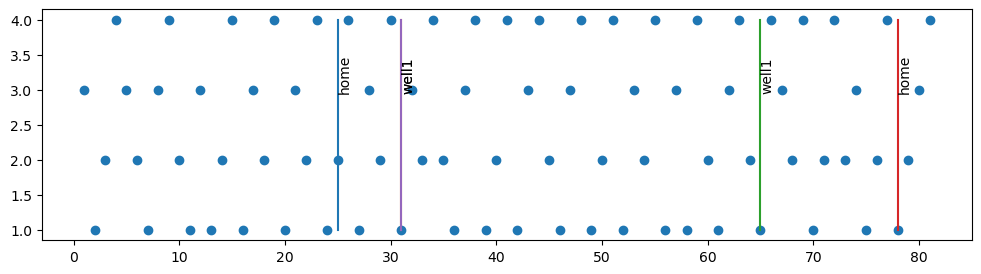

In [651]:
e = 30
u = 3
#ripple_indices = np.concatenate((frag_ripple_index[(e, u)],cont_ripple_index[(e, u)]))
ripple_indices = frag_ripple_index[(e, u)]
fig, axes = plt.subplots(1,1,figsize = (12,3))
axes.scatter(behavior.index,behavior.OuterWellIndex)
for ind in ripple_indices:
    trial = ripple_times.loc[ind].trial_number
    location = ripple_times.loc[ind].animal_location
    axes.plot([trial, trial],[1, 4])
    axes.text(trial,3,location,rotation=90)

### plot all immobolity time spiking animal location for one cell

In [661]:
from spyglass.shijiegu.singleUnit import spikeLocation


[10:00:24][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.


In [663]:
behavior

,timestamp_H,Home,timestamp_O,OuterWellIndex,rewardNum,current,future_H,future_O,past,past_reward
1,1.666477e+09,1.0,1.666477e+09,3.0,2.0,3.0,3.0,1.0,NaN,NaN
2,1.666477e+09,1.0,1.666477e+09,1.0,1.0,1.0,1.0,2.0,3.0,3.0
3,1.666477e+09,1.0,1.666477e+09,2.0,1.0,2.0,2.0,4.0,1.0,3.0
4,1.666477e+09,1.0,1.666477e+09,4.0,2.0,4.0,4.0,3.0,2.0,3.0
5,1.666477e+09,1.0,1.666477e+09,3.0,1.0,3.0,3.0,2.0,4.0,4.0
...,...,...,...,...,...,...,...,...,...,...
78,1.666479e+09,1.0,1.666479e+09,1.0,1.0,1.0,1.0,2.0,4.0,1.0
79,1.666479e+09,1.0,1.666479e+09,2.0,1.0,2.0,2.0,3.0,1.0,1.0
80,1.666479e+09,1.0,1.666479e+09,3.0,2.0,3.0,3.0,4.0,2.0,1.0
81,1.666479e+09,1.0,1.666479e+09,4.0,2.0,4.0,4.0,NaN,3.0,3.0


In [664]:
e = 30
u = 3
imm_spike_time, imm_spike_loc = spikeLocation(nwb_copy_file_name, session_name, pos_name, 30, 3)

[10:04:13][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.


[10:27:20][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[10:27:21][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[10:27:21][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[10:27:22][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[10:27:22][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[10:27:23][WARNING] Spyglass: 

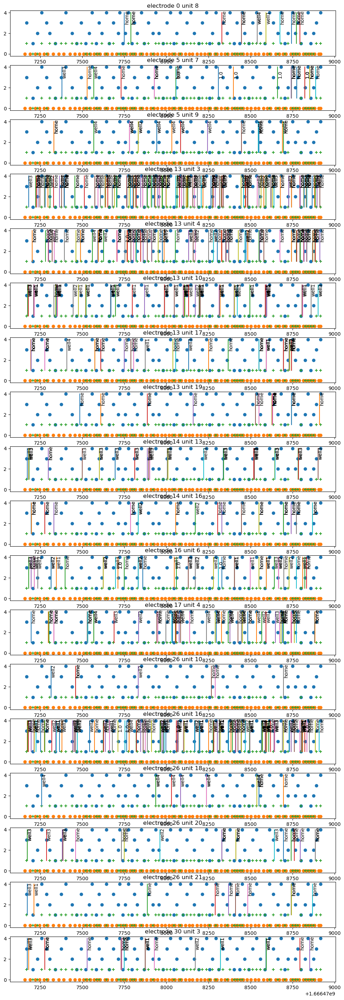

In [676]:
fig, axes = plt.subplots(len(cells_frag),1,figsize = (12,2*len(cells_frag)))

for row_ind in range(len(cells_frag)):
    e = cells_frag[row_ind][0]
    u = cells_frag[row_ind][1]
    imm_spike_time, imm_spike_loc = spikeLocation(nwb_copy_file_name, session_name, pos_name, e, u)

    axes[row_ind].scatter(behavior.timestamp_O,behavior.OuterWellIndex)
    axes[row_ind].scatter(behavior.timestamp_H,np.zeros_like(behavior.timestamp_H))
    axes[row_ind].scatter(behavior.timestamp_O,behavior.rewardNum == 2,marker='+')
    
    for ind in range(len(imm_spike_time)):
        t = imm_spike_time[ind]
        location = imm_spike_loc[ind]
        axes[row_ind].plot([t, t],[1, 4])
        axes[row_ind].text(t,3,location,rotation=90)
        axes[row_ind].set_title('electrode '+str(e)+' unit '+str(u))

### firing rate per cell per ripple they engaged in

In [460]:
cont_ripple_index = {}
for row_ind in range(len(cells_cont)):
    e = cells_cont[row_ind][0]
    u = cells_cont[row_ind][1]
    cont_ripple_index[(e,u)] = np.unique(ParticipatedRippleIndex(nwb_copy_file_name,session_name,
                            ripple_times,e,u,fragFlag = False))

Accepted units:  [3, 4, 6, 7, 8]
Accepted units:  [3, 4, 6, 7, 8]
Accepted units:  [3]
Accepted units:  [2, 5, 6, 7, 8, 9, 11]
Accepted units:  [2, 5, 6, 7, 8, 9, 11]
Accepted units:  [2, 5, 6, 7, 8, 9, 11]
Accepted units:  [2, 3, 4, 7, 8, 9, 10, 12, 13, 14, 15, 16, 17, 18, 19]
Accepted units:  [2, 3, 4, 7, 8, 9, 10, 12, 13, 14, 15, 16, 17, 18, 19]
Accepted units:  [2, 3, 4, 7, 8, 9, 10, 12, 13, 14, 15, 16, 17, 18, 19]
Accepted units:  [2, 3, 4, 7, 8, 9, 10, 12, 13, 14, 15, 16, 17, 18, 19]
Accepted units:  [2, 3, 4, 7, 8, 9, 10, 12, 13, 14, 15, 16, 17, 18, 19]
Accepted units:  [2, 3, 4, 7, 8, 9, 10, 12, 13, 14, 15, 16, 17, 18, 19]
Accepted units:  [2, 3, 4, 7, 8, 9, 10, 12, 13, 14, 15, 16, 17, 18, 19]
Accepted units:  [2, 3, 4, 7, 8, 9, 10, 12, 13, 14, 15, 16, 17, 18, 19]
Accepted units:  [4, 8, 9, 10, 11, 12, 13, 16, 17, 19, 20, 21, 22]
Accepted units:  [4, 8, 9, 10, 11, 12, 13, 16, 17, 19, 20, 21, 22]
Accepted units:  [4, 8, 9, 10, 11, 12, 13, 16, 17, 19, 20, 21, 22]
Accepted units: 

In [465]:
firing_rate_per_cell_frag = []
for row_ind in range(len(cells_frag)):
    e = cells_frag[row_ind][0]
    u = cells_frag[row_ind][1]
    (rate_F, count_F, _) = firing_rate_F[e][u]
    number_of_ripple = len(frag_ripple_index[(e,u)])
    firing_rate_per_cell_frag.append(count_F/number_of_ripple)

firing_rate_per_cell_cont = []
for row_ind in range(len(cells_cont)):
    e = cells_cont[row_ind][0]
    u = cells_cont[row_ind][1]
    (rate_C, count_C, _) = firing_rate_C[e][u]
    number_of_ripple = len(cont_ripple_index[(e,u)])
    firing_rate_per_cell_cont.append(count_C/number_of_ripple)
    

(array([0.        , 0.58928571, 0.26785714, 0.07142857, 0.        ,
        0.01785714, 0.        , 0.03571429, 0.        , 0.        ,
        0.01785714, 0.        , 0.        , 0.        ]),
 array([ 0.,  1.,  2.,  3.,  4.,  5.,  6.,  7.,  8.,  9., 10., 11., 12.,
        13., 14.]),
 <BarContainer object of 14 artists>)

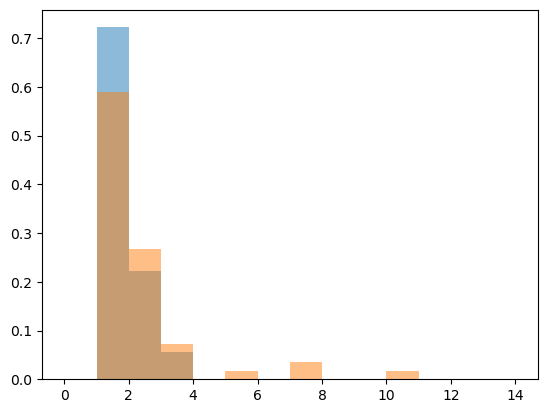

In [476]:
plt.hist(firing_rate_per_cell_frag,bins = np.arange(15),alpha = 0.5,
         weights = np.ones(len(firing_rate_per_cell_frag))/len(firing_rate_per_cell_frag))
plt.hist(firing_rate_per_cell_cont,bins = np.arange(15),alpha = 0.5,
         weights = np.ones(len(firing_rate_per_cell_cont))/len(firing_rate_per_cell_cont))

### number of ripples they participated in

In [86]:
cell_list = cells_frag + cells_cont

In [65]:
from spyglass.shijiegu.singleUnit import ParticipatedRippleIndex

frag_ripple_index = {}
for row_ind in range(len(cell_list)):
    e = cell_list[row_ind][0]
    u = cell_list[row_ind][1]
    frag_ripple_index[(e,u)] = np.unique(ParticipatedRippleIndex(nwb_copy_file_name,session_name,
                            ripple_times,e,u,fragFlag = True))
cont_ripple_index = {}
for row_ind in range(len(cell_list)):
    e = cell_list[row_ind][0]
    u = cell_list[row_ind][1]
    cont_ripple_index[(e,u)] = np.unique(ParticipatedRippleIndex(nwb_copy_file_name,session_name,
                            ripple_times,e,u,fragFlag = False))

In [129]:
num_cont = {}

num = []
for row_ind in range(len(cells_frag)):
    (e,u) = cells_frag[row_ind]
    num.append(len(cont_ripple_index[(e,u)]))
num_cont['frag'] = num

num = []
for row_ind in range(len(cells_cont)):
    (e,u) = cells_cont[row_ind]
    num.append(len(cont_ripple_index[(e,u)]))
num_cont['cont'] = num

num_frag = {}

num = []
for row_ind in range(len(cells_frag)):
    (e,u) = cells_frag[row_ind]
    num.append(len(frag_ripple_index[(e,u)]))
num_frag['frag'] = num

num = []
for row_ind in range(len(cells_cont)):
    (e,u) = cells_cont[row_ind]
    num.append(len(frag_ripple_index[(e,u)]))
num_frag['cont'] = num

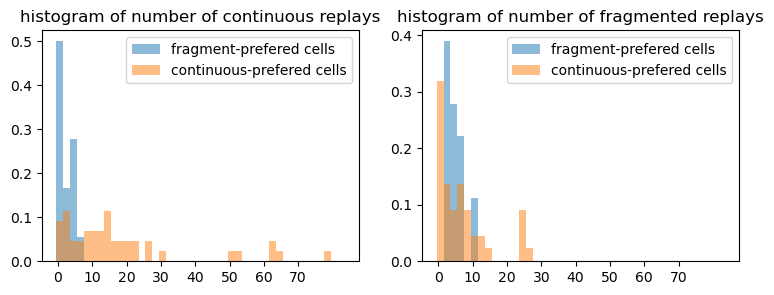

In [136]:
fig, axes = plt.subplots(1,2,figsize = (9,3))

for i in range(2):
    if i == 0:
        data1 = num_cont['frag']
        data2 = num_cont['cont']
        title = 'histogram of number of continuous replays'
    elif i == 1:
        data1 = num_frag['frag']
        data2 = num_frag['cont']
        title = 'histogram of number of fragmented replays'
 
    axes[i].hist(data1,bins = np.arange(0,85,2),alpha = 0.5,
             weights = np.ones(len(data1))/len(data1), label = 'fragment-prefered cells')
    axes[i].hist(data2,bins = np.arange(0,85,2),alpha = 0.5,
             weights = np.ones(len(data2))/len(data2), label = 'continuous-prefered cells')
    axes[i].set_title(title);
    
    axes[i].set_xticks(np.arange(0,80,10)+0.5);
    axes[i].set_xticklabels(np.arange(0,80,10));
    axes[i].legend()

### relationship of the # of fragmented events they participate in and their place field specificity

#### 1. first load place field

In [87]:
placefields = {}
mobility_spike_counts = {}
all_spike_counts = {}
for row_ind in range(len(cell_list)):
    print(row_ind)
    e = cell_list[row_ind][0]
    u = cell_list[row_ind][1]
    placefield, xbins, ybins, mobility_spike_count, all_spike_count = place_field(nwb_copy_file_name, session_name, pos_name, e, u)
    placefields[(e,u)] = placefield
    mobility_spike_counts[(e,u)] = mobility_spike_count
    all_spike_counts[(e,u)] = all_spike_count
    #axes[row_ind].imshow(placefield)
    #axes[row_ind].text(60,80,'spike count: '+str(mobility_spike_count)+'/'+str(all_spike_count))
    #axes[row_ind].set_title('electrode '+str(e) +' unit '+str(u))
        
    #row_ind = row_ind + 1

0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123


In [89]:
import scipy.stats as stats

peak1ds = {}
peak1ds_list = []
entropys = {}
entropys_list = []
maxs = {}
maxs_list = []


for row_ind in range(len(cell_list)):
    print(row_ind)
    e = cell_list[row_ind][0]
    u = cell_list[row_ind][1]
    peak1d = placefield_to_peak1dloc('4 arm lumped 2023', placefields[(e,u)], ybins, xbins)
    peak1ds[(e,u)] = peak1d
    peak1ds_list.append(peak1d)

    placefield_ = placefields[(e,u)][~np.isnan(placefields[(e,u)])]
    p = placefield_.reshape((-1,1))
    entropy = stats.entropy(p,nan_policy='omit')
    entropys[(e,u)] = float(entropy)
    entropys_list.append(entropy)

    max = np.max(placefield_)
    maxs[(e,u)] = max
    maxs_list.append(max)

[10:24:47][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[10:24:47][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[10:24:47][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[10:24:48][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[10:24:48][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[10:24:48][WARNING] Spyglass: 

0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15


[10:24:48][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[10:24:48][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[10:24:48][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[10:24:48][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[10:24:48][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[10:24:48][WARNING] Spyglass: 

16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31


[10:24:48][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[10:24:48][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[10:24:48][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[10:24:48][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[10:24:48][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[10:24:48][WARNING] Spyglass: 

32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47


[10:24:48][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[10:24:48][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[10:24:48][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[10:24:48][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[10:24:48][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[10:24:48][WARNING] Spyglass: 

48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64


[10:24:48][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[10:24:48][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[10:24:48][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[10:24:48][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[10:24:48][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[10:24:48][WARNING] Spyglass: 

65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80


[10:24:49][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[10:24:49][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[10:24:49][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[10:24:49][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[10:24:49][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[10:24:49][WARNING] Spyglass: 

81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96


[10:24:49][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[10:24:49][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[10:24:49][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[10:24:49][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[10:24:49][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[10:24:49][WARNING] Spyglass: 

97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112


[10:24:49][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[10:24:49][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[10:24:49][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[10:24:49][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[10:24:49][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[10:24:49][WARNING] Spyglass: 

113
114
115
116
117
118
119
120
121
122
123


In [110]:
# the number of fragmented ripples they join
num_cont = []
num_frag = []
# entropy of the field
en = []
max = []


for row_ind in range(len(cells_cont)):
    (e,u) = cells_cont[row_ind]
    num_cont.append(len(cont_ripple_index[(e,u)]))
    num_frag.append(len(frag_ripple_index[(e,u)]))
    en.append(entropys[(e,u)])
    max.append(maxs[(e,u)])


Text(6, 85, 'Continuous preferred cell')

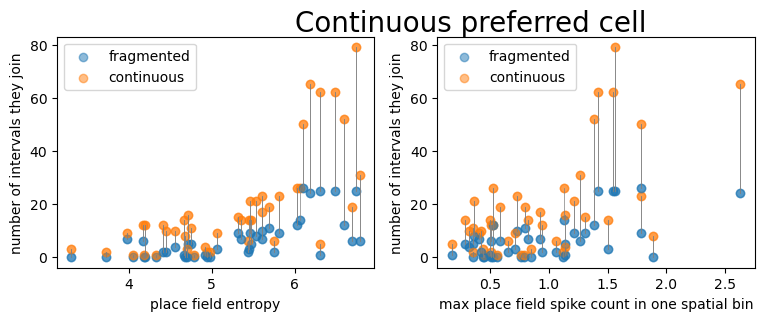

In [122]:
fig, axes = plt.subplots(1,2,figsize = (9,3))

axes[0].scatter(en[0],num_frag[0],color = 'C0',alpha = 0.5,label = 'fragmented')
axes[0].scatter(en[0],num_cont[0],color = 'C1',alpha = 0.5,label = 'continuous')
for row_ind in range(1,len(cells_cont)):
    axes[0].scatter(en[row_ind],num_frag[row_ind],color = 'C0',alpha = 0.5)
    axes[0].scatter(en[row_ind],num_cont[row_ind],color = 'C1',alpha = 0.5)
    axes[0].plot([en[row_ind],en[row_ind]],[num_frag[row_ind],num_cont[row_ind]],color = [0.5,0.5,0.5],linewidth = 0.5)
axes[0].set_xlabel('place field entropy')
axes[0].set_ylabel('number of intervals they join')
axes[0].legend()

axes[1].scatter(max[0],num_frag[0],color = 'C0',alpha = 0.5,label = 'fragmented')
axes[1].scatter(max[0],num_cont[0],color = 'C1',alpha = 0.5,label = 'continuous')
for row_ind in range(1,len(cells_cont)):
    axes[1].scatter(max[row_ind],num_frag[row_ind],color = 'C0',alpha = 0.5)
    axes[1].scatter(max[row_ind],num_cont[row_ind],color = 'C1',alpha = 0.5)
    axes[1].plot([max[row_ind],max[row_ind]],[num_frag[row_ind],num_cont[row_ind]],color = [0.5,0.5,0.5],linewidth = 0.5)
axes[1].set_xlabel('max place field spike count in one spatial bin')
axes[1].set_ylabel('number of intervals they join')
axes[1].legend()

axes[0].text(6,85,'Continuous preferred cell',fontsize = 20)

In [123]:
## for frag cells
# the number of fragmented ripples they join
num_cont = []
num_frag = []
# entropy of the field
en = []
max = []


for row_ind in range(len(cells_frag)):
    (e,u) = cells_frag[row_ind]
    num_cont.append(len(cont_ripple_index[(e,u)]))
    num_frag.append(len(frag_ripple_index[(e,u)]))
    en.append(entropys[(e,u)])
    max.append(maxs[(e,u)])


Text(6, 11, 'Frag preferred cell')

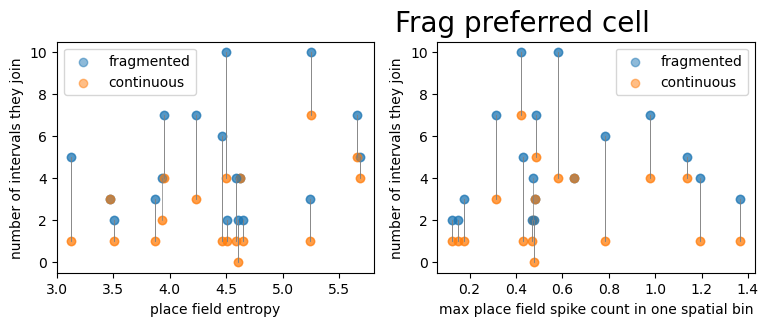

In [127]:
fig, axes = plt.subplots(1,2,figsize = (9,3))

axes[0].scatter(en[0],num_frag[0],color = 'C0',alpha = 0.5,label = 'fragmented')
axes[0].scatter(en[0],num_cont[0],color = 'C1',alpha = 0.5,label = 'continuous')
for row_ind in range(1,len(cells_frag)):
    axes[0].scatter(en[row_ind],num_frag[row_ind],color = 'C0',alpha = 0.5)
    axes[0].scatter(en[row_ind],num_cont[row_ind],color = 'C1',alpha = 0.5)
    axes[0].plot([en[row_ind],en[row_ind]],[num_frag[row_ind],num_cont[row_ind]],color = [0.5,0.5,0.5],linewidth = 0.5)
axes[0].set_xlabel('place field entropy')
axes[0].set_ylabel('number of intervals they join')
axes[0].legend()

axes[1].scatter(max[0],num_frag[0],color = 'C0',alpha = 0.5,label = 'fragmented')
axes[1].scatter(max[0],num_cont[0],color = 'C1',alpha = 0.5,label = 'continuous')
for row_ind in range(1,len(cells_frag)):
    axes[1].scatter(max[row_ind],num_frag[row_ind],color = 'C0',alpha = 0.5)
    axes[1].scatter(max[row_ind],num_cont[row_ind],color = 'C1',alpha = 0.5)
    axes[1].plot([max[row_ind],max[row_ind]],[num_frag[row_ind],num_cont[row_ind]],color = [0.5,0.5,0.5],linewidth = 0.5)
axes[1].set_xlabel('max place field spike count in one spatial bin')
axes[1].set_ylabel('number of intervals they join')
axes[1].legend()

axes[0].text(6,11,'Frag preferred cell',fontsize = 20)

### sort cells by placefield and do raster

In [542]:
import track_linearization as ti
from spyglass.common.common_position import TrackGraph


In [813]:
peak1ds={}
peak1ds_list = []
cell_list = []

for sort_group_id in sort_group_ids:
    nwb_units = electrode_unit(nwb_copy_file_name,session_name,sort_group_id)
    if len(nwb_units)==0:
        continue
    for u in nwb_units.index:
        e = sort_group_id
        placefield, xbins, ybins, mobility_spike_count, all_spike_count = place_field(
            nwb_copy_file_name, session_name, pos_name, e, u)
        peak1d = placefield_to_peak1dloc('4 arm lumped 2023', placefield, ybins, xbins)
        peak1ds[(e,u)] = peak1d
        peak1ds_list.append(peak1d)
        cell_list.append((e,u))

[15:25:44][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[15:25:45][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[15:25:45][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[15:25:46][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[15:25:47][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[15:25:48][WARNING] Spyglass: 

In [1309]:
linear_map,node_location=get_linearization_map()

[14:14:28][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.


In [1319]:
spatial_bins = []
segments_ind = [0,3,5,7,9]
for seg in segments_ind:
    p0p1= linear_map[seg]
    spatial_bins.append(np.linspace(p0p1[0],p0p1[1],10))
spatial_bins = np.concatenate(spatial_bins)

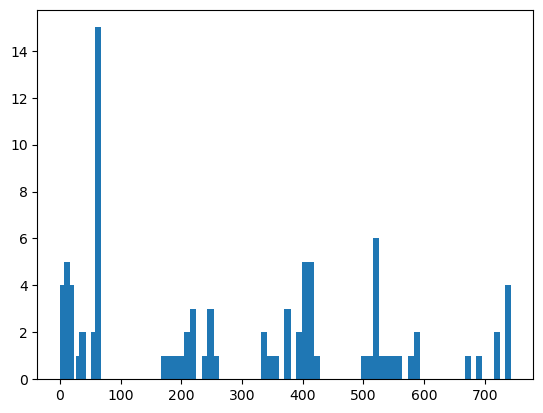

In [1320]:
# distribution of space field peak
plt.hist(peak1ds_list,spatial_bins,width = 10);

In [814]:
cells = np.array(cell_list)[np.argsort(peak1ds_list)]
cell_order = {}
for i in range(cells.shape[0]):
    cell_order[tuple(cells[i])] = i

### develop raster plot

In [577]:
from spyglass.shijiegu.Analysis_SGU import get_linearization_map
from spyglass.shijiegu.load import load_epoch_data
from spyglass.shijiegu.ripple_add_replay import plot_decode_sortedSpikes

In [571]:
TrialChoice() & {'nwb_file_name':nwb_copy_file_name}

nwb_file_name name of the NWB file,epoch the session epoch for this task and apparatus(1 based),"epoch_name session name, get from IntervalList","choice_reward pandas dataframe, choice"
eliot20221022_.nwb,2,02_Seq2Session1,=BLOB=
eliot20221022_.nwb,4,04_Seq2Session2,=BLOB=
eliot20221022_.nwb,6,06_Seq2Session3,=BLOB=
eliot20221022_.nwb,8,08_Seq2Session4,=BLOB=
eliot20221022_.nwb,10,10_Seq2Session5,=BLOB=


In [812]:
linear_map,node_location=get_linearization_map()
encoding_set = '2Dheadspeed_above_4_andlowmua'
classifier_param_name = 'default_decoding_gpu_4armMaze'
decode_threshold_method = 'MUA_0SD'
causal = False

(epoch_name,log_df,decode,head_speed,head_orientation,linear_position_df,
        lfp_df,theta_df,ripple_df,neural_df,_) = load_epoch_data(nwb_copy_file_name,8,
                                                  classifier_param_name,
                                                  encoding_set)

[15:24:37][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.


epoch name 08_Seq2Session4
epoch_pos_name pos 7 valid times


[2024-07-24 15:24:37,597][WARNING]: Skipped checksum for file with hash: 6e8ac500-c1d2-7373-bab6-1ab9c9508c3e, and path: /stelmo/nwb/analysis/eliot20221022/eliot20221022_8CD94Z2Z6X.nwb


In [599]:
ripple_times.loc[ripple_table_ind].start_time

1666477296.0039346

In [742]:
peak1ds

{(0, 3): 81.3932908037696,
 (0, 4): 8.784205646541352,
 (0, 6): 245.30266794058133,
 (0, 7): 83.83532455290923,
 (0, 8): 334.6362351678518,
 (2, 3): 416.78999574439695,
 (5, 2): 11.750948844781497,
 (5, 5): 13.468537012183722,
 (5, 6): 720.3340214448474,
 (5, 7): 85.30054480239299,
 (5, 8): 499.25964754699174,
 (5, 9): 737.2425597896196,
 (5, 11): 208.10579408535483,
 (13, 2): 9.061795653394206,
 (13, 3): 722.1333009151576,
 (13, 4): 33.69790876158744,
 (13, 7): 370.0760118230974,
 (13, 8): 8.923000649967793,
 (13, 9): 741.7143846620845,
 (13, 10): 252.64353221468843,
 (13, 12): 5.487824315163371,
 (13, 13): 15.186125179585918,
 (13, 14): 418.292279561657,
 (13, 15): 414.0603300991062,
 (13, 16): 390.3994047787917,
 (13, 17): 408.5493874832986,
 (13, 18): 731.9502165919318,
 (13, 19): 8.923000649967793,
 (14, 4): 562.0255015220844,
 (14, 8): 245.30266794058133,
 (14, 9): 403.03844486749097,
 (14, 10): 518.9550799943814,
 (14, 11): 583.1876381171415,
 (14, 12): 506.3476962959938,
 (14, 

In [708]:
frag_ripple_index_all = []
for k in frag_ripple_index.keys():
    frag_ripple_index_all.append(frag_ripple_index[k])
frag_ripple_index_all = np.unique(np.concatenate(frag_ripple_index_all))

In [718]:
# savefolder related
decoding_path=(DecodeResultsLinear() & {'nwb_file_name':nwb_copy_file_name}).fetch('posterior')[0]
if causal:
    causal_str = 'causal'
else:
    causal_str = 'acausal'
savefolder = os.path.join(os.path.split(decoding_path)[0],
                        nwb_copy_file_name,
                        'sorted_spike_SWR'+'_'+encoding_set+'_'+causal_str+'_'+classifier_param_name,epoch_name)
isExist = os.path.exists(savefolder)
if not isExist:
    os.makedirs(savefolder)

In [819]:
plot_color = {}
for c in peak1ds.keys():
    plot_color[c] = 'C'+str((c[0]+c[1]) % 8 + 2)
for c in cells_cont:
    plot_color[c] = 'C1'
for c in cells_frag:
    plot_color[c] = 'C0'

In [991]:
shade_time = np.concatenate((np.array(ripple_times['start_time']).reshape((-1,1)),
                             np.array(ripple_times['end_time']).reshape((-1,1))),axis = 1)

In [ ]:
for ripple_table_ind in frag_ripple_index_all: #[19]
    plottimes = [ripple_times.loc[ripple_table_ind].start_time-1, ripple_times.loc[ripple_table_ind].end_time+1]
    savename = 'ripple_ID' + str(ripple_table_ind) + nwb_copy_file_name[:-5] + '_' + epoch_name + '2seconds'
    title = 'ripple_' + str(ripple_table_ind) + '_' + nwb_copy_file_name[:-5] + '_' + epoch_name
    #shadetimes = np.vstack(ripple_times) #all possible shadings, just np.vstack(ripples), remove empty segments
    
    plot_decode_sortedSpikes(nwb_copy_file_name,session_name,plottimes,shade_time,
                             linear_position_df,decode,lfp_df,theta_df,
              neural_df,peak1ds,head_speed,head_orientation,
              ripple_consensus_trace=None,
              title=title,savefolder=savefolder,savename=savename,
              likelihood=False,mua_thresh=0,causal = False,cell_color = plot_color)


### for each fragment only cell, plot trial by trial firing profile, with SWR shading, blue for conti, yellow for fragmented

In [ ]:
from spyglass.shijiegu.singleUnit import plot_firing_rate

In [830]:
StateScript = pd.DataFrame(
        (TrialChoice & {'nwb_file_name':nwb_copy_file_name,'epoch_name':session_name}).fetch1('choice_reward')
    )

In [ ]:
# savefolder related
decoding_path=(DecodeResultsLinear() & {'nwb_file_name':nwb_copy_file_name}).fetch('posterior')[0]
if causal:
    causal_str = 'causal'
else:
    causal_str = 'acausal'
savefolder = os.path.join(os.path.split(decoding_path)[0],
                        nwb_copy_file_name,
                        'sorted_spike_SWR'+'_'+encoding_set+'_'+causal_str+'_'+classifier_param_name,epoch_name)
isExist = os.path.exists(savefolder)
if not isExist:
    os.makedirs(savefolder)

In [ ]:
# make data matrix: from outer well to outer well
maxTime = np.nanmax(np.diff(StateScript.timestamp_O[:-1]))
DELTA_T = 0.04

cells = list(peak1ds.keys())
e_old = -1
for cell in cells:
    e = cell[0]
    u = cell[1]
    
    if e != e_old:
        nwb_units = electrode_unit(nwb_copy_file_name,session_name,e)

    # make firing rate matrix
    firing_rate_matrix = np.zeros((len(StateScript.index[:-2]), int(np.ceil(maxTime/DELTA_T)))) + np.nan
    trials = []

    row_ind = 0
    for t in StateScript.index[:-2]:
        t0 = StateScript.loc[t].timestamp_O
        t1 = StateScript.loc[t+1].timestamp_O
        axis = np.concatenate((np.arange(t0,t1,DELTA_T),np.array([t1])))
    
        spike_times = nwb_units.loc[u].spike_times
        firing_rate_matrix[row_ind,:len(axis)-1],_ = np.histogram(spike_times, axis)
        trials.append(t)
        row_ind = row_ind + 1
        
    if len(set([(e,u)]).intersection(set(cells_frag)))>0:
        savename = 'fragmented_cell_firing_rate_electrode'+str(e)+'_unit'+str(u)
    else:
        savename = 'continuous_cell_firing_rate_electrode'+str(e)+'_unit'+str(u)
    plot_firing_rate(StateScript,nwb_copy_file_name,e,u,
                 DELTA_T,trials,firing_rate_matrix,ripple_times,savefolder,savename)

### find cell assemblies during fragmented replays

In [1321]:
ripple_times.loc[157]

start_time                                    1666478744.274282
end_time                                      1666478744.410283
animal_location                                            home
trial_number                                                 72
fragmented_type                                           [[2]]
cont_intvl           [[1666478744.2750337, 1666478744.3430336]]
frag_intvl           [[1666478744.3450336, 1666478744.4090335]]
cont_intvl_replay                                         [[3]]
duration                                                  0.136
mean_zscore                                            1.791754
median_zscore                                          1.529701
max_zscore                                             3.964513
min_zscore                                            -0.355976
speed_at_start                                         2.982183
speed_at_end                                            2.98219
max_speed                               

In [1040]:
#electrodes_units[e].loc[u].spike_times

In [1041]:
# load unit data
key = {"nwb_file_name": nwb_copy_file_name,
       "sorter":"mountainsort4",
       "sort_interval_name":session_name}
sort_group_ids = np.unique((QualityMetrics & key).fetch("sort_group_id"))

sort_group_ids_with_good_cell = []       
electrodes_units = {}
for sort_group_id in sort_group_ids:
    nwb_units = electrode_unit(nwb_copy_file_name,session_name,sort_group_id)
    if len(nwb_units)==0:
        continue
    electrodes_units[sort_group_id] = nwb_units
    sort_group_ids_with_good_cell.append(sort_group_id)

In [1270]:
cells = list(peak1ds.keys())
DELTA_T = 0.1

firing_matrix_all = []
axis_all = []
r_ind_all =[]

for r_ind in ripple_times.index:
    intvls = ripple_times.loc[r_ind].frag_intvl
    
    for intvl in intvls:
        #axis_tmp = np.arange(intvl[0],intvl[1],DELTA_T)
        #axis = np.concatenate((axis_tmp,np.array([np.max([intvl[1]+DELTA_T,axis_tmp[-1]])]))) #take care of end
        axis = intvl
        firing_matrix = np.zeros((len(cells),len(axis)-1))
    
        e_old = -1
        i = 0
        for cell in cells:
            e = cell[0]
            u = cell[1]
            firing_matrix[i,:], _ = np.histogram(electrodes_units[e].loc[u].spike_times,axis)
            i = i + 1
            
        firing_matrix = firing_matrix / np.diff(intvl)
        firing_matrix_all.append(firing_matrix)
        axis_all.append(axis[:-1])
        r_ind_all.append(np.zeros_like(axis[:-1]) + r_ind)

In [1271]:
axis_all = np.concatenate(axis_all)
r_ind_all = np.concatenate(r_ind_all)
firing_matrix = np.concatenate(firing_matrix_all,axis=1)

In [1272]:
firing_matrix.shape

(90, 61)

In [1276]:
from sklearn.manifold import SpectralEmbedding

embedding = SpectralEmbedding(n_components=3,affinity='nearest_neighbors',n_neighbors=5) #n_neighbors=10
X_transformed = embedding.fit_transform(firing_matrix.T)
print(X_transformed.shape)
N = embedding.affinity_matrix_.toarray()

(61, 3)


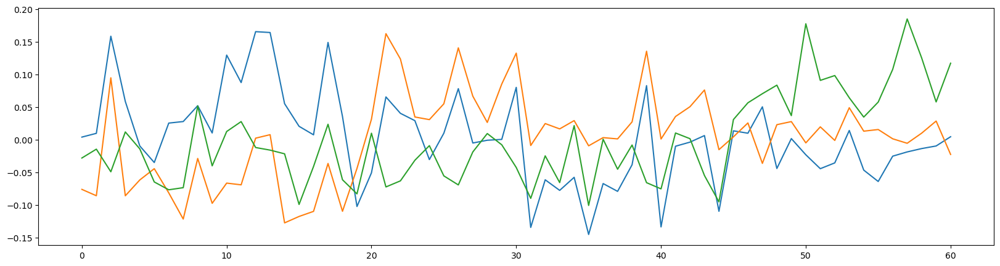

In [1280]:
replay_group = np.argmax(X_transformed,axis = 1)
sort_ind = np.argsort(replay_group)

fig,axes=plt.subplots(1,1,figsize=(20,5))
plt.plot(X_transformed[sort_ind,:])

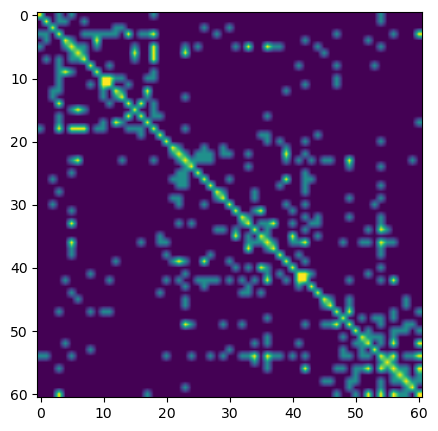

In [1281]:
%matplotlib inline

#sort_ind = np.argsort(N[10,:]) #np.argsort(N[10,:])

fig,axes=plt.subplots(1,1,figsize=(5,5))
plt.imshow(N[sort_ind,:][:,sort_ind],interpolation='bilinear', rasterized=False)

In [1282]:
#find cell groups
loading = X_transformed.T @ firing_matrix.T
C_transformed = embedding.fit_transform(loading.T)
C_transformed.shape
cell_group = np.argmax(C_transformed.T,axis=0)

In [1283]:
plot_color = {}
for cell_ind in range(len(cells)):
    e = cells[cell_ind][0]
    u = cells[cell_ind][1]
    plot_color[(e,u)] = 'C'+str(cell_group[cell_ind]+2)

In [1284]:
time_ind = np.logical_and(axis_all>=t0, axis_all<t1)

In [1285]:
ripple_times.loc[5]

start_time                                   1666477196.156844
end_time                                     1666477196.514844
animal_location                                           home
trial_number                                                 2
cont_intvl           [[1666477196.1572258, 1666477196.449226]]
frag_intvl            [[1666477196.451226, 1666477196.491226]]
cont_intvl_replay                                        [[1]]
duration                                              0.358001
mean_zscore                                           1.945267
median_zscore                                         1.670207
max_zscore                                            6.004021
min_zscore                                           -0.443112
speed_at_start                                         0.11858
speed_at_end                                          0.075129
max_speed                                              0.11858
min_speed                                             0

### ripple type and animal location

In [1290]:
ripple_times.insert(4,'fragmented_type',[[] for i in range(len(ripple_times))])

In [1294]:
for ripple_table_ind in frag_ripple_index_all: #[19]
    for intvl in ripple_times.loc[ripple_table_ind].frag_intvl:
        (t0,t1) = intvl
    
        time_ind = np.logical_and(axis_all>=t0, axis_all<t1)
        replay_group_strip = replay_group[time_ind]
        ripple_times.loc[ripple_table_ind].fragmented_type.append(replay_group_strip)

[14:05:36][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[14:05:36][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.


here 666


[14:05:44][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[14:05:44][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.


here 666


[14:05:52][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[14:05:52][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.


here 666


[14:06:01][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[14:06:01][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.


here 666


[14:06:09][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[14:06:09][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.


here 666


[14:06:17][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[14:06:17][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.


here 666


[14:06:25][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[14:06:25][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.


here 666


[14:06:32][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[14:06:32][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.


here 666


[14:06:40][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[14:06:40][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.


here 666


[14:06:48][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[14:06:48][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.


here 666


[14:06:56][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[14:06:56][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.


here 666


[14:07:04][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[14:07:04][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.


here 666


[14:07:11][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[14:07:11][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.


here 666


[14:07:19][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[14:07:19][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.


here 666


[14:07:27][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[14:07:27][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.


here 666


[14:07:35][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[14:07:35][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.


here 666


[14:07:43][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[14:07:43][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.


here 666


[14:07:51][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[14:07:51][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.


here 666


[14:07:59][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[14:07:59][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.


here 666


[14:08:07][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[14:08:07][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.


here 666


[14:08:15][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[14:08:15][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.


here 666


[14:08:26][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[14:08:26][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.


here 666


[14:08:33][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[14:08:33][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.


here 666


[14:08:41][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[14:08:41][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.


here 666


[14:08:49][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[14:08:49][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.


here 666


[14:08:56][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[14:08:56][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.


here 666


[14:09:04][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[14:09:04][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.


here 666


[14:09:12][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[14:09:12][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.


here 666


[14:09:20][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[14:09:20][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.


here 666


[14:09:27][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[14:09:27][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.


here 666


[14:09:35][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[14:09:35][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.


here 666


[14:09:43][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[14:09:43][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.


here 666


[14:09:50][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[14:09:50][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.


here 666


[14:09:58][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[14:09:58][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.


here 666


[14:10:06][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[14:10:06][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.


here 666


[14:10:14][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.
[14:10:14][WARNING] Spyglass: Deprecation: this class has been moved out of spyglass.common.common_position
	TrackGraph -> spyglass.linearization.v0.main.TrackGraph
Please use the new location.


here 666


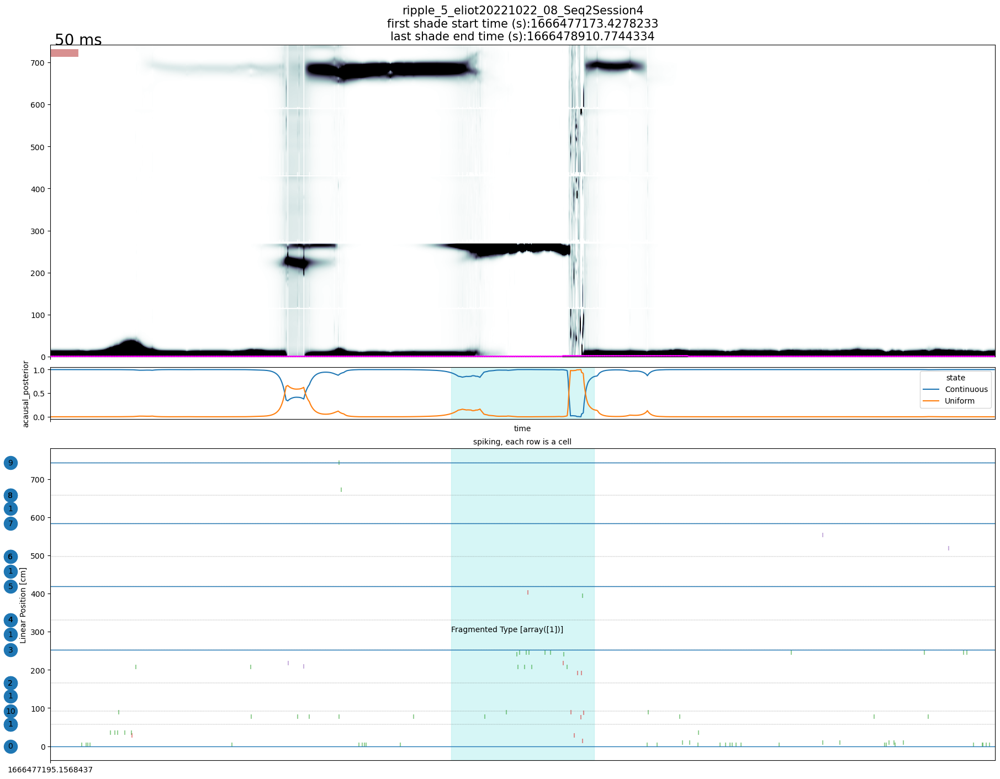

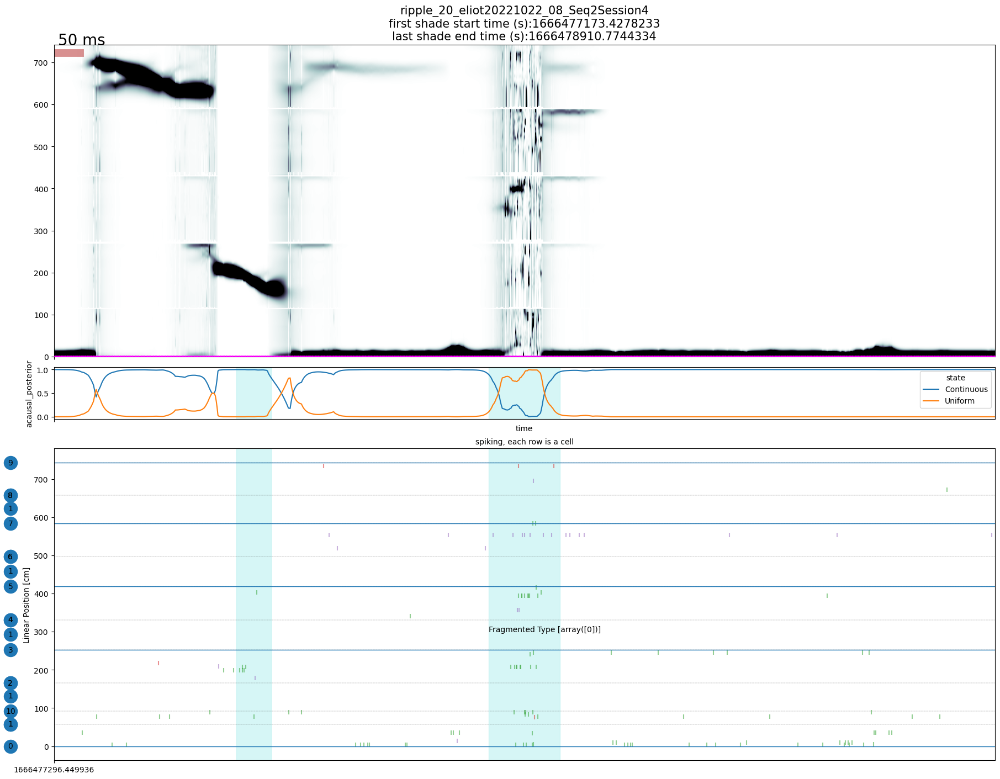

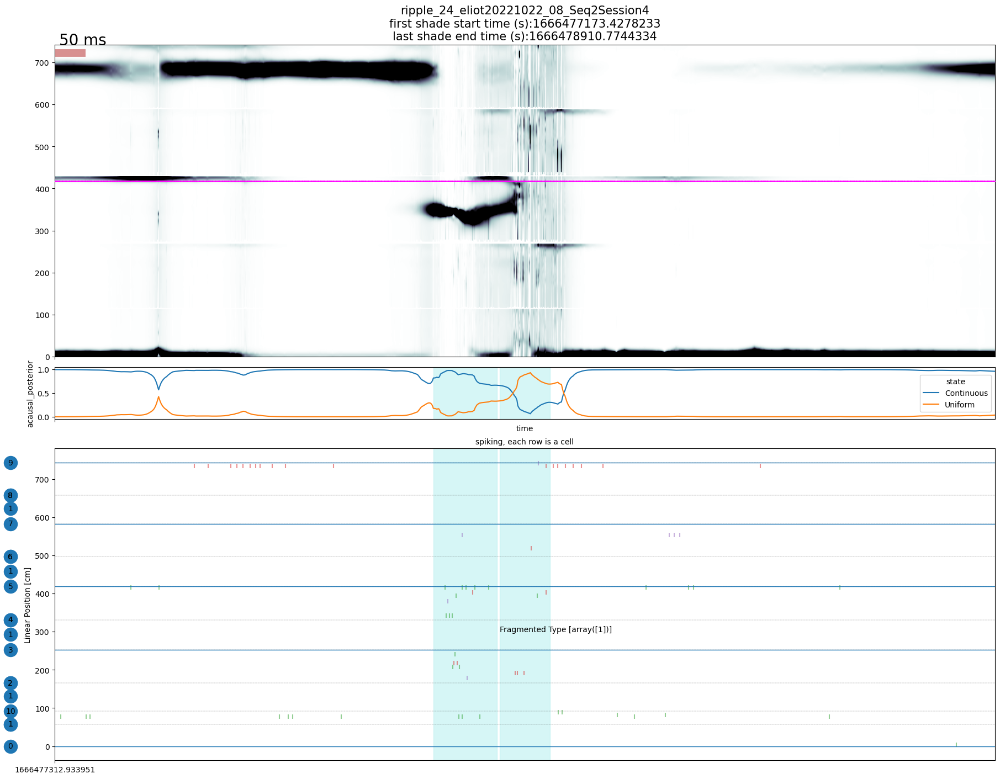

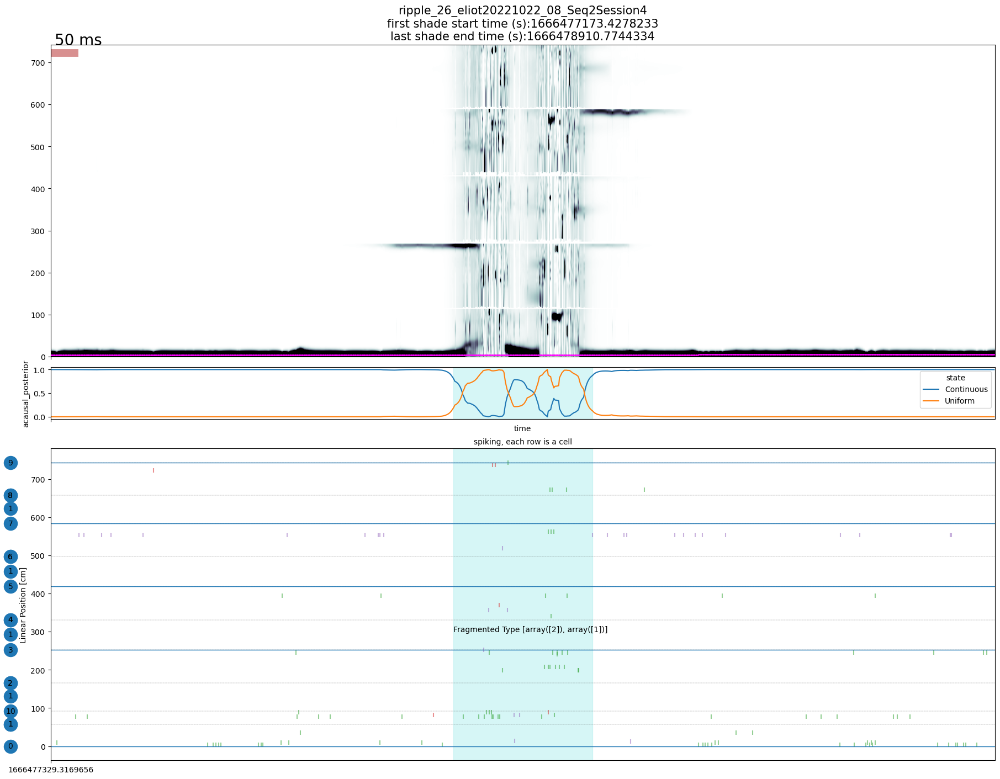

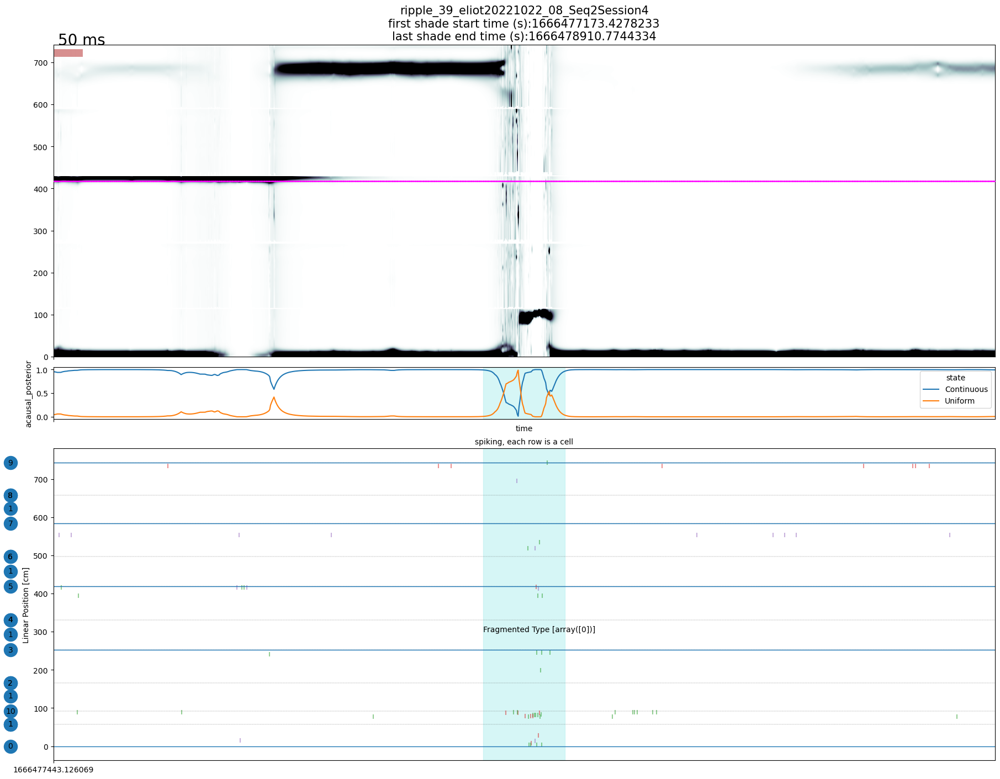

...

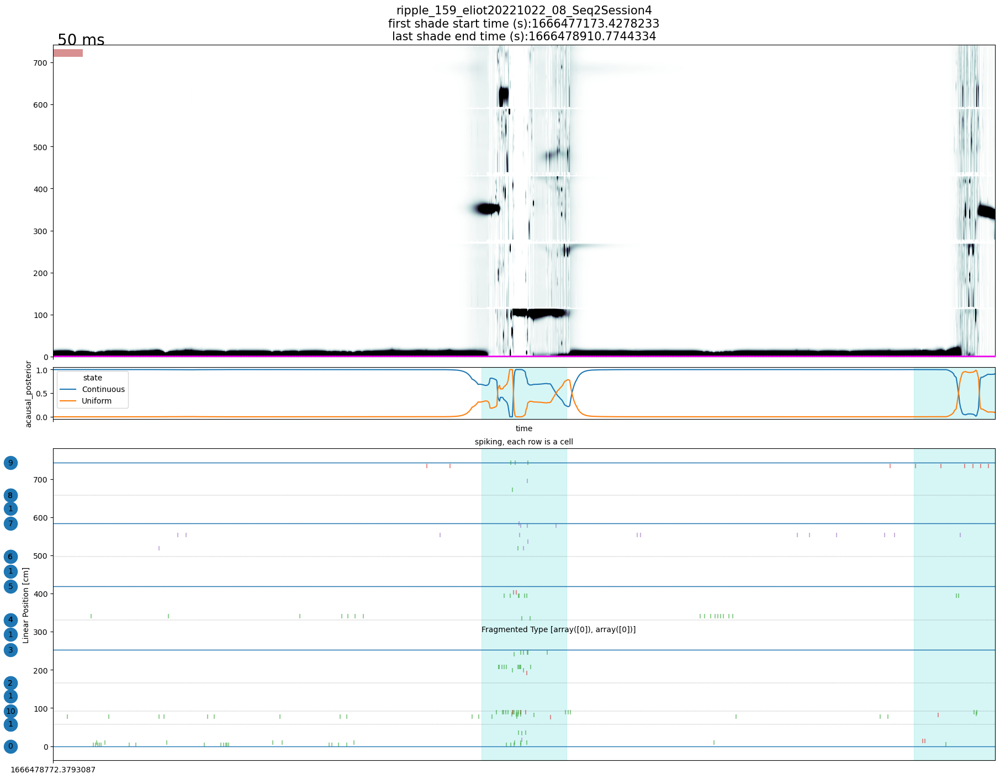

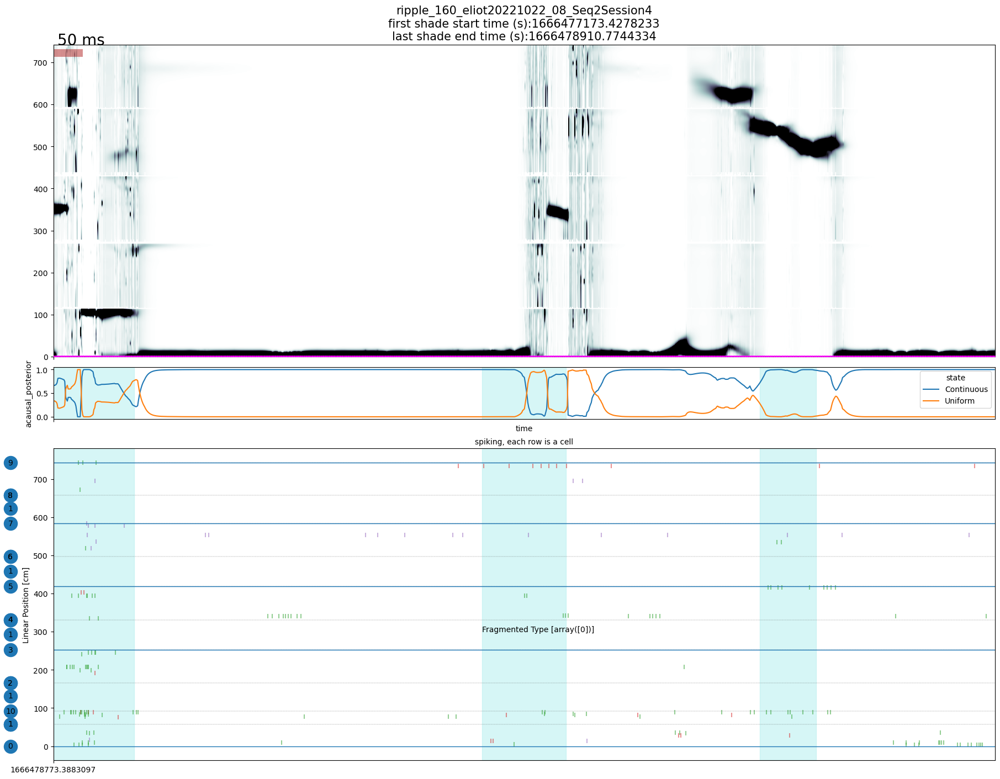

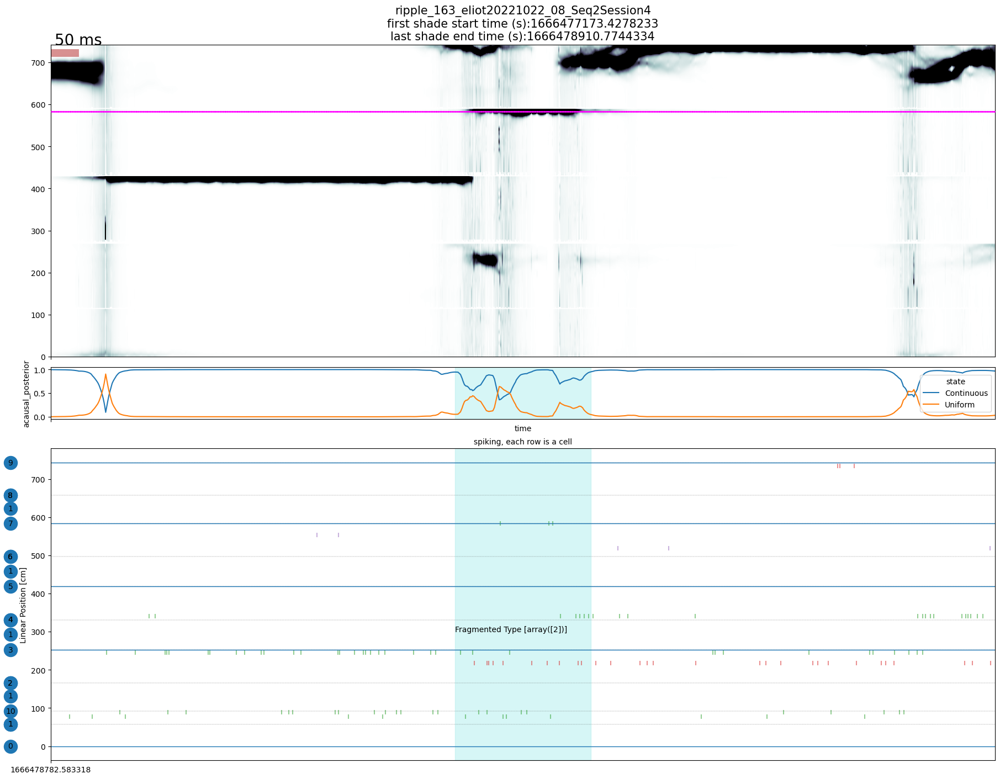

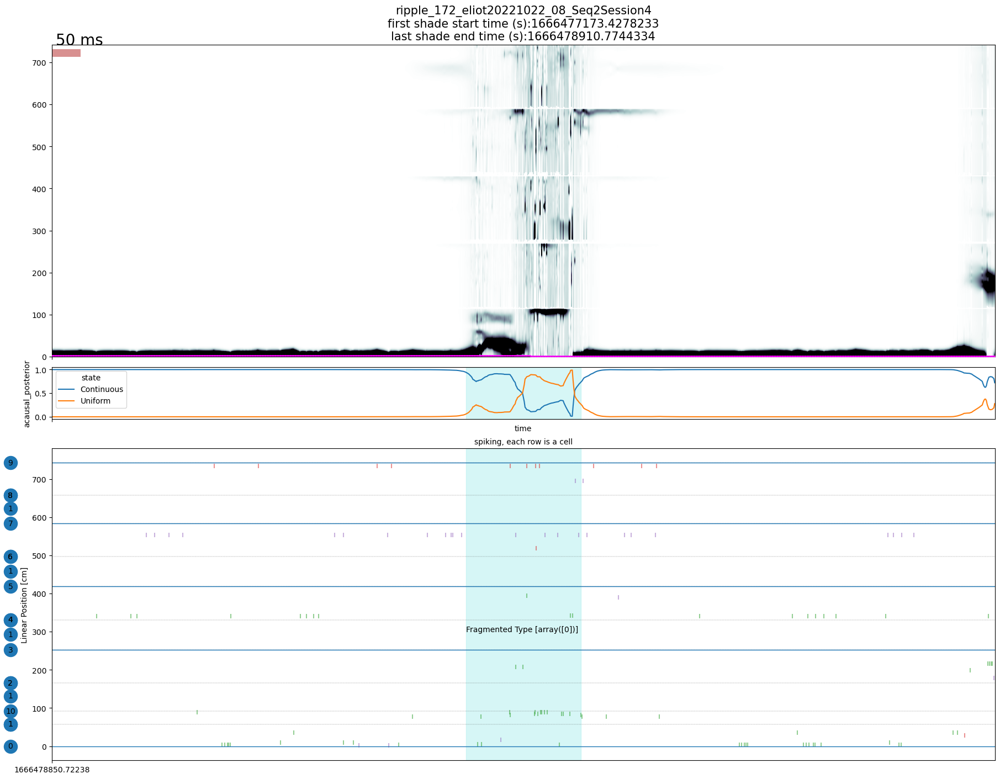

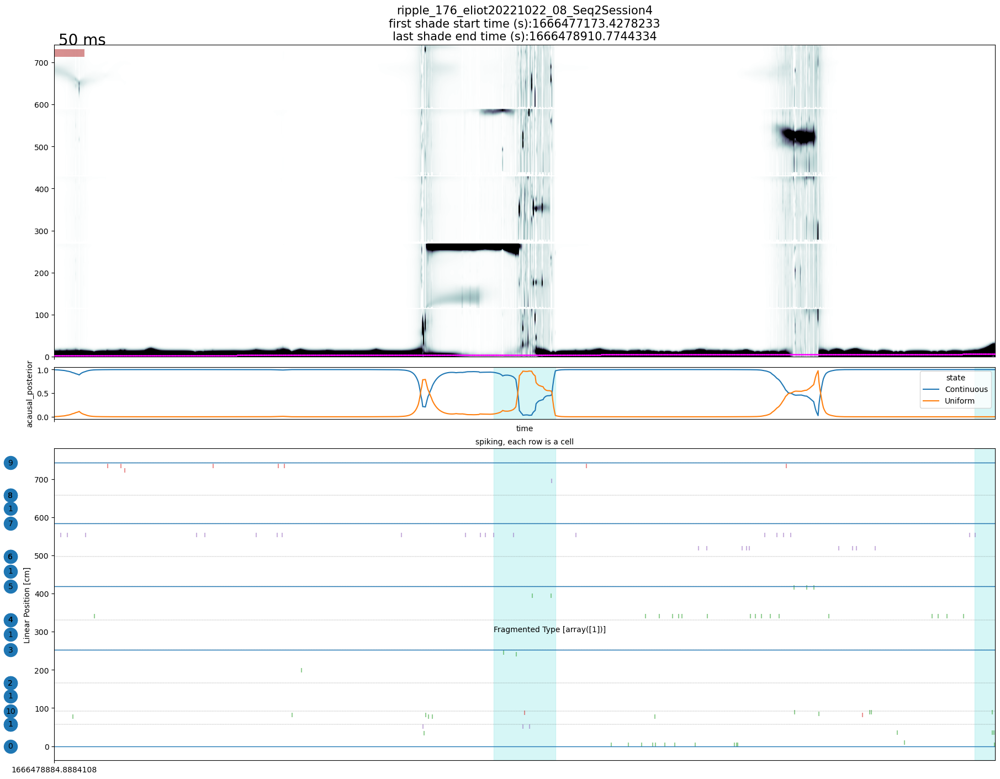

In [1307]:
# Do the same plots as above, but color with cell group

# savefolder related
decoding_path=(DecodeResultsLinear() & {'nwb_file_name':nwb_copy_file_name}).fetch('posterior')[0]
if causal:
    causal_str = 'causal'
else:
    causal_str = 'acausal'
savefolder = os.path.join(os.path.split(decoding_path)[0],
                        nwb_copy_file_name,
                        'byCellGroup_k=3_Sorted_spike_SWR'+'_'+encoding_set+'_'+causal_str+'_'+classifier_param_name,epoch_name)
isExist = os.path.exists(savefolder)
if not isExist:
    os.makedirs(savefolder)
    
for ripple_table_ind in frag_ripple_index_all: #[19]
    t0 = ripple_times.loc[ripple_table_ind].start_time
    t1 = ripple_times.loc[ripple_table_ind].end_time

    #time_ind = np.logical_and(axis_all>=t0, axis_all<t1)
    replay_group_time = t0
    replay_group_text = 'Fragmented Type '+str(ripple_times.loc[ripple_table_ind].fragmented_type)

    
    plottimes = [t0-1, t1+1]
    savename = 'ripple_ID' + str(ripple_table_ind) + nwb_copy_file_name[:-5] + '_' + epoch_name + '2seconds_cellgroups'
    title = 'ripple_' + str(ripple_table_ind) + '_' + nwb_copy_file_name[:-5] + '_' + epoch_name
    #shadetimes = np.vstack(ripple_times) #all possible shadings, just np.vstack(ripples), remove empty segments
    
    plot_decode_sortedSpikes(nwb_copy_file_name,session_name,plottimes,shade_time,
                             linear_position_df,decode,lfp_df,theta_df,
              neural_df,peak1ds,head_speed,head_orientation,
              ripple_consensus_trace=None,
              title=title,savefolder=savefolder,savename=savename,
              likelihood=False,mua_thresh=0,causal = False,cell_color = plot_color,
                             replay_type_time = replay_group_time, replay_type = replay_group_text)


In [1303]:
frag_replay_type = {}
for row_ind in range(len(cells_frag)):
    e = cells_frag[row_ind][0]
    u = cells_frag[row_ind][1]
    ripple_indices = frag_ripple_index[(e,u)]
    frag_replay_type[(e,u)] = [ripple_times.loc[r_ind].fragmented_type for r_ind in ripple_indices]

In [1304]:
frag_replay_type

{(0, 8): [[array([1])], [array([2]), array([0])], [array([1])], [array([0])]],
 (5, 7): [[array([0])],
  [array([0])],
  [array([1]), array([1])],
  [array([0])],
  [array([0])],
  [array([0])]],
 (5, 9): [[array([2]), array([1])],
  [array([1]), array([1])],
  [array([1])],
  [array([2])],
  [array([1])]],
 (13, 3): [[array([2])], [array([1]), array([1])]],
 (13, 4): [[array([0])], [array([2]), array([0])], [array([0])], [array([0])]],
 (13, 10): [[array([2]), array([1])], [array([1]), array([1])]],
 (13, 17): [[array([2])],
  [array([1]), array([0])],
  [array([1])],
  [array([1])],
  [array([2])],
  [array([1])],
  [array([2])]],
 (13, 19): [[array([0])], [array([2])], [array([0])]],
 (14, 13): [[array([0])], [array([0]), array([0])], [array([2])]],
 (14, 16): [[array([1])],
  [array([2]), array([1])],
  [array([1]), array([1])],
  [array([1]), array([0])],
  [array([1])],
  [array([2]), array([2]), array([1])],
  [array([1])],
  [array([2])],
  [array([1]), array([1])],
  [array([0

In [1301]:
frag_type_animal_location = {}
for g in np.unique(replay_group):
    frag_type_animal_location[g] = []
    
for ripple_table_ind in frag_ripple_index_all: #[19]
    for intvl_ind in np.arange(len(ripple_times.loc[ripple_table_ind].frag_intvl)):
        animal_location = ripple_times.loc[ripple_table_ind].animal_location
        g = ripple_times.loc[ripple_table_ind].fragmented_type[intvl_ind][0]
        frag_type_animal_location[g].append(animal_location)

In [1302]:
frag_type_animal_location

{0: ['home',
  'well2',
  'home',
  'home',
  'home',
  'home',
  'home',
  'home',
  'home',
  'home',
  'home',
  'home',
  'home',
  'home',
  'home',
  'home'],
 1: ['home',
  'well2',
  'home',
  'home',
  'home',
  'well2',
  'well2',
  'well1',
  'well1',
  'home',
  'well3',
  'well2',
  'home',
  'home',
  'home',
  'well1',
  'well1',
  'home',
  'home',
  'home',
  'home'],
 2: ['home',
  'home',
  'home',
  'well2',
  'home',
  'home',
  'home',
  'home',
  'home',
  'home',
  'well3']}

In [1306]:
ripple_times.loc[20]

start_time                                    1666477297.449936
end_time                                      1666477297.613936
animal_location                                            home
trial_number                                                  6
fragmented_type                                           [[0]]
cont_intvl           [[1666477297.5792134, 1666477297.6132133]]
frag_intvl           [[1666477297.4732134, 1666477297.5772133]]
cont_intvl_replay                                          [[]]
duration                                                  0.164
mean_zscore                                            5.477071
median_zscore                                          2.725607
max_zscore                                            20.068431
min_zscore                                            -0.694243
speed_at_start                                         0.119185
speed_at_end                                           0.119185
max_speed                               

### find problemetic cells

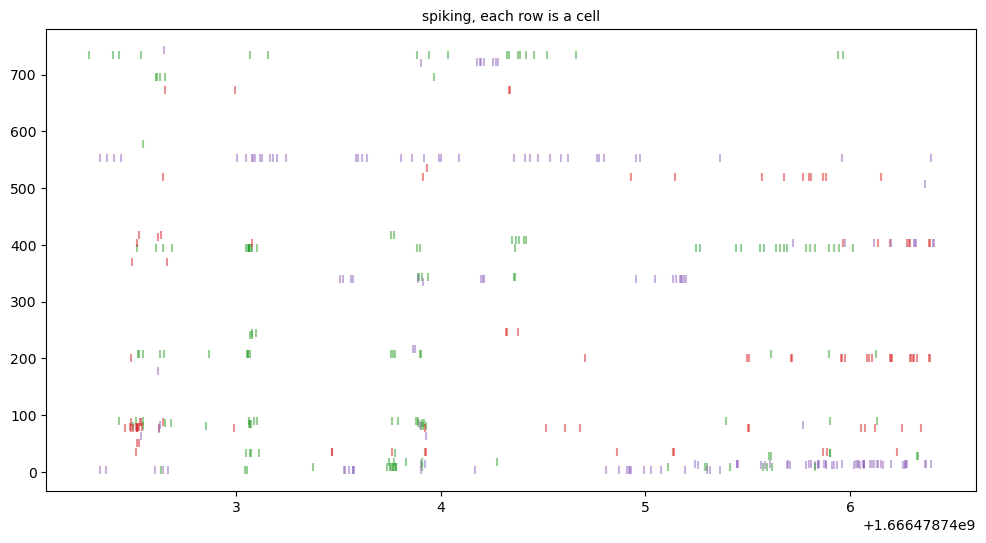

In [1119]:
fig, axes = plt.subplots(1,1,figsize = (12,6))

ripple_table_ind = 157
plottimes = [ripple_times.loc[ripple_table_ind].start_time-2, ripple_times.loc[ripple_table_ind].end_time+2]
cells = list(peak1ds.keys())
e_old = -1
for cell in cells:
    e = cell[0]
    u = cell[1]
    if e != e_old:
        nwb_units = electrode_unit(nwb_copy_file_name,session_name,e)

    spike_times = nwb_units.loc[u].spike_times
    spike_times = spike_times[np.logical_and(spike_times >= plottimes[0],spike_times <= plottimes[1])]

    #axes.scatter(spike_times, np.zeros(len(spike_times)) + peak1ds[(e,u)],rasterized=True,color = 'C'+str(u%6),marker='|',alpha = 0.5)
    axes.scatter(spike_times, np.zeros(len(spike_times)) + peak1ds[(e,u)],rasterized=True,color = plot_color[(e,u)],marker='|',alpha = 0.5)
    #axes.text(plottimes[0]-1+e/2+u/4,peak1ds[(e,u)],str(e)+' '+str(u),color = 'C'+str(u%6))
    axes.set_title('spiking, each row is a cell',size=10)
    e_old = e.copy()

array([29.705484])

In [758]:
problem_cells = [(17,2),(20,11),(23,4),(13,18)]

17 2
20 11
23 4
13 18


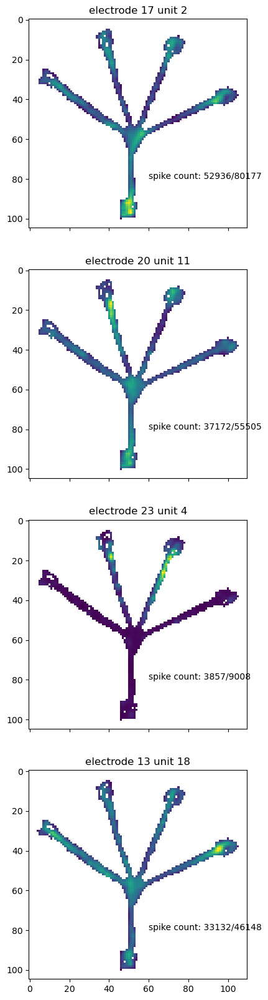

In [759]:
fig, axes = plt.subplots(len(problem_cells),1,figsize = (5,5*len(problem_cells)),sharex = 1)

row_ind = 0
#for electrode_ind in range(len(electrodes_frag)):
for row_ind in range(len(problem_cells)):
    e = problem_cells[row_ind][0]
    u = problem_cells[row_ind][1]
    print(e,u)
    placefield, xbins, ybins, mobility_spike_count, all_spike_count = place_field(nwb_copy_file_name, session_name, pos_name, e, u)
    axes[row_ind].imshow(placefield)
    axes[row_ind].text(60,80,'spike count: '+str(mobility_spike_count)+'/'+str(all_spike_count))
    axes[row_ind].set_title('electrode '+str(e) +' unit '+str(u))
        
    row_ind = row_ind + 1

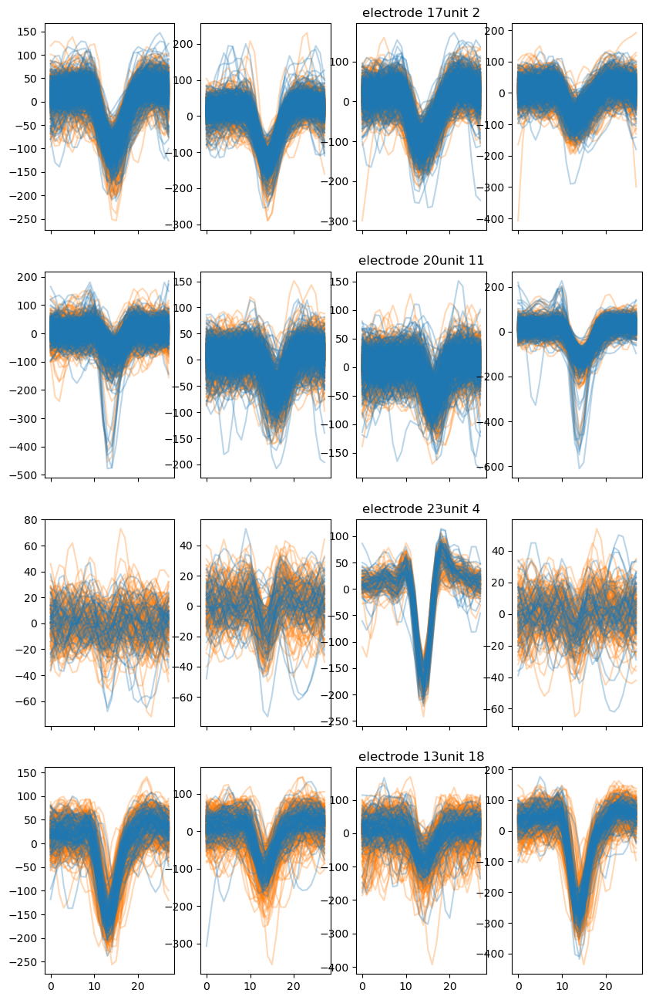

In [761]:
fig, axes = plt.subplots(len(problem_cells),4,figsize = (10,4*len(problem_cells)),sharex = 1)

row_ind = 0
for row_ind in range(len(problem_cells)):
    e = problem_cells[row_ind][0]
    u = problem_cells[row_ind][1]
    nwb_units,extractor = findWaveForms(nwb_copy_file_name,session_name,e)
    waveforms = extractor.get_waveforms(u)

    # continuous time waveforms
    ind_cont = RippleTime2Index(nwb_units.loc[u].spike_times,ripple_times,fragFlag = False)
    (sample_num,clip_size,channel_num) = waveforms.shape
    
    for s_ind in range(len(ind_cont)):
        s = ind_cont[s_ind]
        for ch in range(channel_num):
            axes[row_ind,ch].plot(waveforms[s,:,ch].squeeze(),'C1',alpha = 0.3)

    # fragmented time waveforms
    ind_frag = RippleTime2Index(nwb_units.loc[u].spike_times,ripple_times,fragFlag = True)
    (sample_num,clip_size,channel_num) = waveforms.shape
    
    for s_ind in range(len(ind_frag)):
        s = ind_frag[s_ind]
        for ch in range(channel_num):
            axes[row_ind,ch].plot(waveforms[s,:,ch].squeeze(),'C0',alpha = 0.3)
            
    axes[row_ind,2].set_title('electrode '+str(e)+'unit '+str(u))

### find patterns in the raster